<a href="https://colab.research.google.com/github/sertuxito/Data-Cience-II/blob/main/tpFinal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Abstract
##Titulo
#"Analisis de Intervenciones de la Policia de Nueva York donde se genera un intercambio de tiros"

##Hipótesis
El objetivo de este análisis y estudio es identificar las geolocalizaciones donde es más probable la ocurrencia de una baja humana si ocurre un intercambio de balas con la policía. Identificar estos lugares permitirá elaborar planes de prevención, como equipar las áreas con cámaras de seguridad, salas de primeros auxilios o establecer sectores de vigilancia permanente para evitar futuras bajas. Además, si se desarrolla un evento, se podrá alertar a los policías que van a intervenir sobre las geolocalizaciones de riesgo.

##Motivación
La motivación detrás de este estudio es mejorar la seguridad pública y reducir las bajas humanas en incidentes de tiroteo con la policía. Al identificar las áreas de alto riesgo, se pueden implementar medidas preventivas efectivas que protejan tanto a los ciudadanos como a los oficiales de policía. Este análisis también puede ayudar a optimizar la asignación de recursos y mejorar la respuesta de emergencia en situaciones críticas.

##Audiencia
Este estudio está dirigido a las autoridades policiales, los responsables de la seguridad pública, los planificadores urbanos y los investigadores en criminología. También puede ser de interés para organizaciones comunitarias y defensores de los derechos humanos que buscan mejorar la seguridad y la justicia en sus comunidades.

##Contexto Comercial y Analítico
En el contexto comercial, este análisis puede ser utilizado por empresas de tecnología de seguridad para desarrollar soluciones innovadoras que ayuden a prevenir incidentes de tiroteo. En el ámbito analítico, los datos obtenidos pueden ser utilizados para realizar estudios más profundos sobre la relación entre la ubicación geográfica y la incidencia de tiroteos, así como para desarrollar modelos predictivos que ayuden a anticipar y prevenir futuros incidentes



In [2]:
# Importar librerías
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import gdown
import seaborn as sns
from sklearn.preprocessing import OneHotEncoder, LabelEncoder, MinMaxScaler, StandardScaler
from scipy.stats import skew
from sklearn.model_selection import train_test_split
import time
from sklearn import metrics
from sklearn.metrics import confusion_matrix

%matplotlib inline
sns.set(style="whitegrid")

import warnings
warnings.filterwarnings('ignore')

In [2]:
# Cargar un CSV de GitHub
url='https://raw.githubusercontent.com/sertuxito/Data-Cience-II/refs/heads/main/NYPD_Shooting_Incident_Data__Historic_.csv'
df=pd.read_csv(url,sep=',',header=0)
df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,244608249,05/05/2022,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,M,BLACK,25-44,M,BLACK,986050.000,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692)
1,247542571,07/04/2022,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,(null),(null),18-24,M,BLACK,1016802.000,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402)
2,84967535,05/27/2012,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,NaN,NaN,18-24,M,BLACK,1048632.000,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007)
3,202853370,09/24/2019,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,M,UNKNOWN,25-44,M,BLACK,1014493.000,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075)
4,27078636,02/25/2007,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,M,BLACK,25-44,M,BLACK,1009149.375,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,03/19/2023,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,M,BLACK,18-24,M,BLACK,1025687.000,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785)
28558,272968931,08/16/2023,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,(null),False,...,F,BLACK,45-64,M,BLACK,1014639.000,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549)
28559,270489846,06/27/2023,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,M,BLACK,25-44,M,BLACK,1012221.000,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404)
28560,271021661,07/08/2023,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,M,WHITE HISPANIC,65+,M,ASIAN / PACIFIC ISLANDER,1028856.000,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717)


In [3]:
df.describe()

,INCIDENT_KEY,PRECINCT,JURISDICTION_CODE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude
count,2.856200e+04,28562.000000,28560.000000,2.856200e+04,28562.000000,28503.000000,28503.000000
mean,1.274058e+08,65.496009,0.321884,1.009424e+06,208380.075755,40.738570,-73.909099
std,7.804340e+07,27.342643,0.733035,1.830111e+04,31917.509528,0.087611,0.065967
min,9.953245e+06,1.000000,0.000000,9.149281e+05,125756.718750,40.511586,-74.249303
25%,6.543991e+07,44.000000,0.000000,1.000068e+06,182912.000000,40.668648,-73.942917
50%,9.271125e+07,67.000000,0.000000,1.007772e+06,194901.390625,40.701467,-73.915068
75%,2.031320e+08,81.000000,0.000000,1.016807e+06,239814.234375,40.824878,-73.882366
max,2.797581e+08,123.000000,2.000000,1.066815e+06,271127.687500,40.910818,-73.702046


Se realiza describe aunque las variabes numericas sobre las que tiene efecto esta operacion carece de significancia ya que las variables numericas del dataset son Insicent_key identificador clave del dataset que es una codificacion númerica, el numero del precinto que tanbien es un identificador unico para cada precinto policial de l aciudad, el codigo de jurisdiccion al igual que los anteriores don numeros identificadores, y luego tenemos las cooedenadas latitud y longitud donde se realizaron cada uno de los incidentes. No es significativo ni el promedio ni la medio ni los percentiles de cada uno de estas colunas o variables.

In [25]:
df.duplicated().sum()

np.int64(0)

NO hay duplicados

In [41]:
df.describe(include=['object']).T

,count,unique,top,freq
OCCUR_DATE,28562,6095,07/05/2020,47
OCCUR_TIME,28562,1423,23:30:00,185
BORO,28562,5,BROOKLYN,11346
LOC_OF_OCCUR_DESC,2966,2,OUTSIDE,2506
LOC_CLASSFCTN_DESC,2966,10,STREET,1886
LOCATION_DESC,13585,40,MULTI DWELL - PUBLIC HOUS,5007
PERP_AGE_GROUP,19218,11,18-24,6438
PERP_SEX,19252,4,M,16168
PERP_RACE,19252,8,BLACK,11903
VIC_AGE_GROUP,28562,7,25-44,12973


Se realiza describe incluyendo object para porder analizar el tipo de datos de las variables categoricas del dataset
Luego
tratamiento de fecha y hora..

In [4]:
# Convertir la columna 'transaction_date' a tipo datetime
df['OCCUR_DATE'] = pd.to_datetime(df['OCCUR_DATE'])
# Convertir la columna 'OCCUR_TIME' a tipo datetime y luego extraer la hora
df['OCCUR_TIME'] = pd.to_datetime(df['OCCUR_TIME'], format='%H:%M:%S').dt.time
df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,244608249,2022-05-05,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,M,BLACK,25-44,M,BLACK,986050.000,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692)
1,247542571,2022-07-04,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,(null),(null),18-24,M,BLACK,1016802.000,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402)
2,84967535,2012-05-27,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,NaN,NaN,18-24,M,BLACK,1048632.000,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007)
3,202853370,2019-09-24,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,M,UNKNOWN,25-44,M,BLACK,1014493.000,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075)
4,27078636,2007-02-25,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,M,BLACK,25-44,M,BLACK,1009149.375,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,2023-03-19,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,M,BLACK,18-24,M,BLACK,1025687.000,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785)
28558,272968931,2023-08-16,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,(null),False,...,F,BLACK,45-64,M,BLACK,1014639.000,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549)
28559,270489846,2023-06-27,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,M,BLACK,25-44,M,BLACK,1012221.000,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404)
28560,271021661,2023-07-08,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,M,WHITE HISPANIC,65+,M,ASIAN / PACIFIC ISLANDER,1028856.000,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717)


In [5]:
# Extraer componentes de la fecha
df['Occur_year'] = df['OCCUR_DATE'].dt.year
df['Occur_month'] = df['OCCUR_DATE'].dt.month
df['Occur_day'] = df['OCCUR_DATE'].dt.day
df['Occur_hour'] = df['OCCUR_TIME'].apply(lambda x: x.hour) # Change this line to use .hour attribute of datetime.time object
df['Occur_minute'] = df['OCCUR_TIME'].apply(lambda x: x.minute) # Change this line to use .minute attribute of datetime.time object
df['Occur_dayofweek'] = df['OCCUR_DATE'].dt.dayofweek  # Día de la semana (0 = Lunes, 6 = Domingo)

# Mostrar las primeras filas para verificar
df[['OCCUR_DATE', 'Occur_year', 'Occur_month', 'Occur_day',
    'Occur_hour', 'Occur_minute', 'Occur_dayofweek']].head()

,OCCUR_DATE,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek
0,2022-05-05,2022,5,5,0,10,3
1,2022-07-04,2022,7,4,22,20,0
2,2012-05-27,2012,5,27,19,35,6
3,2019-09-24,2019,9,24,21,0,1
4,2007-02-25,2007,2,25,21,0,6


In [6]:
df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,Y_COORD_CD,Latitude,Longitude,Lon_Lat,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek
0,244608249,2022-05-05,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692),2022,5,5,0,10,3
1,247542571,2022-07-04,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402),2022,7,4,22,20,0
2,84967535,2012-05-27,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007),2012,5,27,19,35,6
3,202853370,2019-09-24,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075),2019,9,24,21,0,1
4,27078636,2007-02-25,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004),2007,2,25,21,0,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,2023-03-19,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785),2023,3,19,23,48,6
28558,272968931,2023-08-16,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,(null),False,...,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549),2023,8,16,2,46,2
28559,270489846,2023-06-27,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404),2023,6,27,12,27,1
28560,271021661,2023-07-08,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717),2023,7,8,11,27,5


In [45]:
df.describe(include=['object']).T

,count,unique,top,freq
OCCUR_TIME,28562,1423,23:30:00,185
BORO,28562,5,BROOKLYN,11346
LOC_OF_OCCUR_DESC,2966,2,OUTSIDE,2506
LOC_CLASSFCTN_DESC,2966,10,STREET,1886
LOCATION_DESC,13585,40,MULTI DWELL - PUBLIC HOUS,5007
PERP_AGE_GROUP,19218,11,18-24,6438
PERP_SEX,19252,4,M,16168
PERP_RACE,19252,8,BLACK,11903
VIC_AGE_GROUP,28562,7,25-44,12973
VIC_SEX,28562,3,M,25790


In [46]:
df.describe().T

,count,mean,min,25%,50%,75%,max,std
INCIDENT_KEY,28562.0,127405824.280092,9953245.0,65439914.0,92711253.5,203131993.0,279758069.0,78043401.210112
OCCUR_DATE,28562,2014-06-07 07:03:45.110286336,2006-01-01 00:00:00,2009-09-04 06:00:00,2013-09-20 00:00:00,2019-09-29 18:00:00,2023-12-29 00:00:00,NaN
PRECINCT,28562.0,65.496009,1.0,44.0,67.0,81.0,123.0,27.342643
JURISDICTION_CODE,28560.0,0.321884,0.0,0.0,0.0,0.0,2.0,0.733035
X_COORD_CD,28562.0,1009424.371714,914928.0625,1000068.09375,1007772.4375,1016807.0625,1066815.375,18301.108087
Y_COORD_CD,28562.0,208380.075755,125756.71875,182912.0,194901.390625,239814.234375,271127.6875,31917.509528
Latitude,28503.0,40.73857,40.511586,40.668648,40.701467,40.824878,40.910818,0.087611
Longitude,28503.0,-73.909099,-74.249303,-73.942917,-73.915068,-73.882366,-73.702046,0.065967
Occur_year,28562.0,2013.908585,2006.0,2009.0,2013.0,2019.0,2023.0,5.392277
Occur_month,28562.0,6.804566,1.0,5.0,7.0,9.0,12.0,3.135386


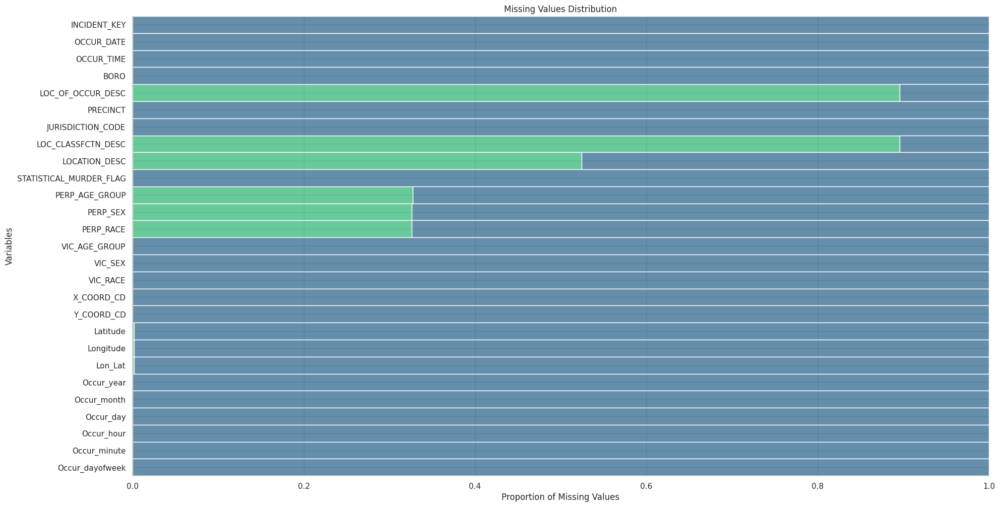

In [7]:
# Graficamos para ver la distribución de los nulos
(dfgraf:= df.isnull().melt()).pipe(
    lambda df: (
        sns.displot(
            data=df,
            y='variable',
            hue='value',
            multiple='fill',
            aspect=2,         # Reducir el aspect ratio para que sea más ancho
            height=10,        # Ajustar la altura del gráfico
            palette='viridis',# Cambiar la paleta de colores
            legend=False       # Desactivar la leyenda para ahorrar espacio
        )
    )
)

# Añadir etiquetas
plt.title('Missing Values Distribution')
plt.xlabel('Proportion of Missing Values')
plt.ylabel('Variables')
plt.show()

In [48]:
df.isnull().sum()

,0
INCIDENT_KEY,0
OCCUR_DATE,0
OCCUR_TIME,0
BORO,0
LOC_OF_OCCUR_DESC,25596
PRECINCT,0
JURISDICTION_CODE,2
LOC_CLASSFCTN_DESC,25596
LOCATION_DESC,14977
STATISTICAL_MURDER_FLAG,0


In [8]:
# Resumimos todo con un contador de valores nulos por cada variable
nulos_por_variable = df.isnull()
cantidad_nulos_por_variable = nulos_por_variable.sum() # Sumamos los valores booleanos para obtener la cantidad de nulos por variable
variables_con_nulos = cantidad_nulos_por_variable[cantidad_nulos_por_variable > 0] # Filtramos solo las variables con al menos un valor nulo
lista_variables_con_nulos = variables_con_nulos.index.tolist() # Convertimos a lista

for variable in lista_variables_con_nulos:
    cantidad_nulos = cantidad_nulos_por_variable[variable]
    porcentaje_nulos = (cantidad_nulos / len(df)) * 100
    print(f"Variable: {variable}, Cantidad de Nulos: {cantidad_nulos}, Porcentaje: {porcentaje_nulos:.2f}%")

Variable: LOC_OF_OCCUR_DESC, Cantidad de Nulos: 25596, Porcentaje: 89.62%
Variable: JURISDICTION_CODE, Cantidad de Nulos: 2, Porcentaje: 0.01%
Variable: LOC_CLASSFCTN_DESC, Cantidad de Nulos: 25596, Porcentaje: 89.62%
Variable: LOCATION_DESC, Cantidad de Nulos: 14977, Porcentaje: 52.44%
Variable: PERP_AGE_GROUP, Cantidad de Nulos: 9344, Porcentaje: 32.71%
Variable: PERP_SEX, Cantidad de Nulos: 9310, Porcentaje: 32.60%
Variable: PERP_RACE, Cantidad de Nulos: 9310, Porcentaje: 32.60%
Variable: Latitude, Cantidad de Nulos: 59, Porcentaje: 0.21%
Variable: Longitude, Cantidad de Nulos: 59, Porcentaje: 0.21%
Variable: Lon_Lat, Cantidad de Nulos: 59, Porcentaje: 0.21%


In [31]:
# Reemplazar los valores (null) con NaN
df.replace('(null)', pd.NA, inplace=True)

# Reemplazar los valores NaN con la moda de cada columna
#for column in df.columns:
 #   mode_value = df[column].mode()[0]
  #  df[column].fillna(mode_value, inplace=True)

In [9]:
df['PERP_SEX'].fillna(df['PERP_SEX'].fillna('U'), inplace=True)
df['PERP_RACE'].fillna(df['PERP_RACE'].mode()[0], inplace=True)
df['PERP_AGE_GROUP'].fillna(df['PERP_AGE_GROUP'].mode()[0], inplace=True)

In [10]:
#esumimos todo con un contador de valores nulos por cada variable
nulos_por_variable = df.isnull()
cantidad_nulos_por_variable = nulos_por_variable.sum() # Sumamos los valores booleanos para obtener la cantidad de nulos por variable
variables_con_nulos = cantidad_nulos_por_variable[cantidad_nulos_por_variable > 0] # Filtramos solo las variables con al menos un valor nulo
lista_variables_con_nulos = variables_con_nulos.index.tolist() # Convertimos a lista

for variable in lista_variables_con_nulos:
    cantidad_nulos = cantidad_nulos_por_variable[variable]
    porcentaje_nulos = (cantidad_nulos / len(df)) * 100
    print(f"Variable: {variable}, Cantidad de Nulos: {cantidad_nulos}, Porcentaje: {porcentaje_nulos:.2f}%")

Variable: LOC_OF_OCCUR_DESC, Cantidad de Nulos: 25596, Porcentaje: 89.62%
Variable: JURISDICTION_CODE, Cantidad de Nulos: 2, Porcentaje: 0.01%
Variable: LOC_CLASSFCTN_DESC, Cantidad de Nulos: 25596, Porcentaje: 89.62%
Variable: LOCATION_DESC, Cantidad de Nulos: 14977, Porcentaje: 52.44%
Variable: Latitude, Cantidad de Nulos: 59, Porcentaje: 0.21%
Variable: Longitude, Cantidad de Nulos: 59, Porcentaje: 0.21%
Variable: Lon_Lat, Cantidad de Nulos: 59, Porcentaje: 0.21%


In [11]:
df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,Y_COORD_CD,Latitude,Longitude,Lon_Lat,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek
0,244608249,2022-05-05,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692),2022,5,5,0,10,3
1,247542571,2022-07-04,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402),2022,7,4,22,20,0
2,84967535,2012-05-27,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007),2012,5,27,19,35,6
3,202853370,2019-09-24,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075),2019,9,24,21,0,1
4,27078636,2007-02-25,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004),2007,2,25,21,0,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,2023-03-19,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785),2023,3,19,23,48,6
28558,272968931,2023-08-16,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,(null),False,...,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549),2023,8,16,2,46,2
28559,270489846,2023-06-27,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404),2023,6,27,12,27,1
28560,271021661,2023-07-08,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717),2023,7,8,11,27,5


In [12]:
print(df['PERP_RACE'].unique())

['BLACK' '(null)' 'UNKNOWN' 'WHITE HISPANIC' 'BLACK HISPANIC'
 'ASIAN / PACIFIC ISLANDER' 'WHITE' 'AMERICAN INDIAN/ALASKAN NATIVE']


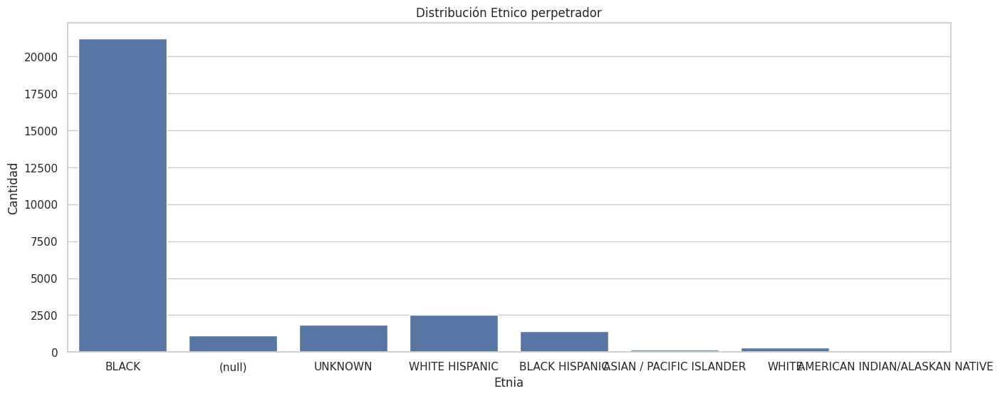

In [13]:
# Contar la frecuencia de cada sexo de las víctimas
sex_counts = df['PERP_RACE'].value_counts()

# Crear un gráfico de barras
plt.figure(figsize=(16, 6))  # Ajustar el tamaño del gráfico si es necesario
sns.countplot(x='PERP_RACE', data=df)
plt.title('Distribución Etnico perpetrador')
plt.xlabel('Etnia')
plt.ylabel('Cantidad')
plt.show()

In [14]:
print(df['PERP_SEX'].unique())

['M' '(null)' 'U' 'F']


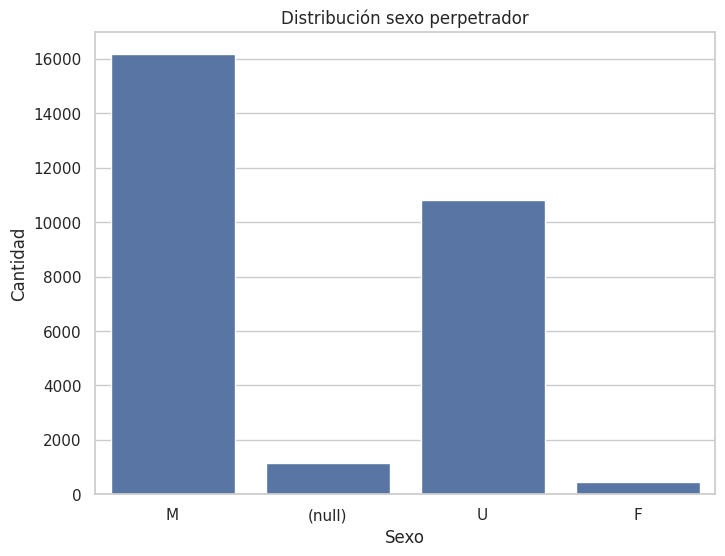

In [15]:

# Contar la frecuencia de cada sexo de las víctimas
sex_counts = df['PERP_SEX'].value_counts()

# Crear un gráfico de barras
plt.figure(figsize=(8, 6))  # Ajustar el tamaño del gráfico si es necesario
sns.countplot(x='PERP_SEX', data=df)
plt.title('Distribución sexo perpetrador')
plt.xlabel('Sexo')
plt.ylabel('Cantidad')
plt.show()

In [57]:
df.isnull().sum()

,0
INCIDENT_KEY,0
OCCUR_DATE,0
OCCUR_TIME,0
BORO,0
LOC_OF_OCCUR_DESC,25596
PRECINCT,0
JURISDICTION_CODE,2
LOC_CLASSFCTN_DESC,25598
LOCATION_DESC,16688
STATISTICAL_MURDER_FLAG,0


In [16]:
# Reemplazar los valores (null) con NaN
df.replace('(null)', pd.NA, inplace=True)

# Reemplazar los valores NaN con la moda de cada columna
for column in df.columns:
    mode_value = df[column].mode()[0]
    df[column].fillna(mode_value, inplace=True)

Uso la moda ya que no se son valores categoricos no numericos..

In [37]:
df.isnull().sum()


,0
INCIDENT_KEY,0
OCCUR_DATE,0
OCCUR_TIME,0
BORO,0
LOC_OF_OCCUR_DESC,0
PRECINCT,0
JURISDICTION_CODE,0
LOC_CLASSFCTN_DESC,0
LOCATION_DESC,0
STATISTICAL_MURDER_FLAG,0


In [17]:
df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,Y_COORD_CD,Latitude,Longitude,Lon_Lat,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek
0,244608249,2022-05-05,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692),2022,5,5,0,10,3
1,247542571,2022-07-04,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,MULTI DWELL - PUBLIC HOUS,True,...,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402),2022,7,4,22,20,0
2,84967535,2012-05-27,19:35:00,QUEENS,OUTSIDE,103,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007),2012,5,27,19,35,6
3,202853370,2019-09-24,21:00:00,BRONX,OUTSIDE,42,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075),2019,9,24,21,0,1
4,27078636,2007-02-25,21:00:00,BROOKLYN,OUTSIDE,83,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004),2007,2,25,21,0,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,2023-03-19,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785),2023,3,19,23,48,6
28558,272968931,2023-08-16,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549),2023,8,16,2,46,2
28559,270489846,2023-06-27,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404),2023,6,27,12,27,1
28560,271021661,2023-07-08,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717),2023,7,8,11,27,5


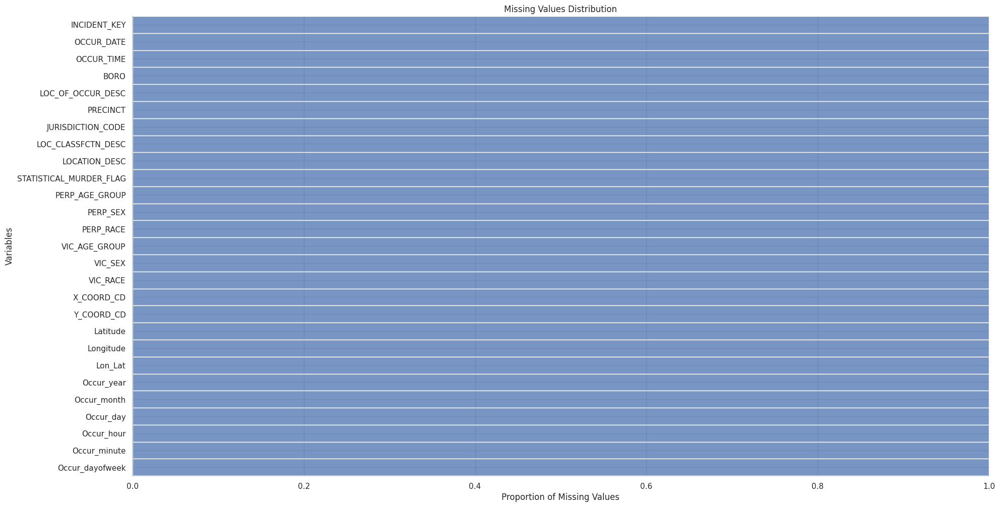

In [18]:
# Graficamos para ver la distribución de los nulos
(dfgraf:= df.isnull().melt()).pipe(
    lambda df: (
        sns.displot(
            data=df,
            y='variable',
            hue='value',
            multiple='fill',
            aspect=2,         # Reducir el aspect ratio para que sea más ancho
            height=10,        # Ajustar la altura del gráfico
            palette=None,# Cambiar la paleta de colores
            legend=False       # Desactivar la leyenda para ahorrar espacio
        )
    )
)

# Añadir etiquetas
plt.title('Missing Values Distribution')
plt.xlabel('Proportion of Missing Values')
plt.ylabel('Variables')
plt.show()

Luego del tratamiento de nulos y el tratamiento de fechas y hora el dataset quedo asi.

In [40]:
df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,Y_COORD_CD,Latitude,Longitude,Lon_Lat,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek
0,244608249,2022-05-05,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692),2022,5,5,0,10,3
1,247542571,2022-07-04,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,MULTI DWELL - PUBLIC HOUS,True,...,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402),2022,7,4,22,20,0
2,84967535,2012-05-27,19:35:00,QUEENS,OUTSIDE,103,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007),2012,5,27,19,35,6
3,202853370,2019-09-24,21:00:00,BRONX,OUTSIDE,42,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075),2019,9,24,21,0,1
4,27078636,2007-02-25,21:00:00,BROOKLYN,OUTSIDE,83,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004),2007,2,25,21,0,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,2023-03-19,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785),2023,3,19,23,48,6
28558,272968931,2023-08-16,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549),2023,8,16,2,46,2
28559,270489846,2023-06-27,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404),2023,6,27,12,27,1
28560,271021661,2023-07-08,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717),2023,7,8,11,27,5


In [19]:
# INFORMACIÓN GENERAL DEL DATASET
print("\nInformación general del dataset:")
df.info()


Información general del dataset:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28562 entries, 0 to 28561
Data columns (total 27 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   INCIDENT_KEY             28562 non-null  int64         
 1   OCCUR_DATE               28562 non-null  datetime64[ns]
 2   OCCUR_TIME               28562 non-null  object        
 3   BORO                     28562 non-null  object        
 4   LOC_OF_OCCUR_DESC        28562 non-null  object        
 5   PRECINCT                 28562 non-null  int64         
 6   JURISDICTION_CODE        28562 non-null  float64       
 7   LOC_CLASSFCTN_DESC       28562 non-null  object        
 8   LOCATION_DESC            28562 non-null  object        
 9   STATISTICAL_MURDER_FLAG  28562 non-null  bool          
 10  PERP_AGE_GROUP           28562 non-null  object        
 11  PERP_SEX                 28562 non-null  object        
 12

# Descripción de variables
# Diccionario de datos

INCIDENT_KEY: Identificador único para cada incidente.

  Tipo: Categórica nominal (ID)

OCCUR_DATE: Fecha en la que ocurrió el incidente (MM/DD/AAAA).

  Tipo: Categórica ordinal (fecha)

OCCUR_TIME: Hora en la que ocurrió el incidente (HH/MM/SS).

  Tipo: Categórica ordinal (hora)

BORO: Barrio o distrito donde ocurrió el incidente.

  Tipo: Categórica nominal

LOC_OF_OCCUR_DESC: Descripción de la ubicación del incidente.

  Tipo: Categórica nominal

PRECINCT: Número de precinto donde ocurrió el incidente.

  Tipo: Numérica discreta

JURISDICTION_CODE: Código de jurisdicción del incidente.

  Tipo: Numérica de razón

LOC_CLASSFCTN_DESC: Descripción de la clasificación de la ubicación.

  Tipo: Categórica nominal

LOCATION_DESC: Descripción adicional de la ubicación.

  Tipo: Categórica nominal

STATISTICAL_MURDER_FLAG: Indicador de si el incidente se considera un asesinato estadístico.

  Tipo: Categórica nominal (booleano)

PERP_AGE_GROUP: Grupo de edad del perpetrador.

  Tipo: Categórica nominal

PERP_SEX: Sexo del perpetrador.

  Tipo: Categórica nominal

PERP_RACE: Raza del perpetrador.

  Tipo: Categórica nominal

VIC_AGE_GROUP: Grupo de edad de la víctima.

  Tipo: Categórica nominal

VIC_SEX: Sexo de la víctima.

  Tipo: Categórica nominal

VIC_RACE: Raza de la víctima.

  Tipo: Categórica nominal

X_COORD_CD: Coordenada X de la ubicación del incidente.

  Tipo: Numérica de razón

Y_COORD_CD: Coordenada Y de la ubicación del incidente.

  Tipo: Numérica de razón

Latitude: Latitud de la ubicación del incidente.

  Tipo: Numérica de razón

Longitude: Longitud de la ubicación del incidente.

  Tipo: Numérica de razón

Lon_Lat: Combinación de latitud y longitud en formato de cadena.

  Tipo: Categórica nominal

Occur_year: El año en que ocurrió el evento.

  Tipo: Numérica de razón (int32)

Occur_month: El mes en que ocurrió el evento.

  Tipo: Numérica de razón (int32)

Occur_day: El día del mes en que ocurrió el evento.

  Tipo: Numérica de razón (int32)

Occur_hour: La hora del día en que ocurrió el evento.

  Tipo: Numérica de razón (int64)

Occur_minute: El minuto de la hora en que ocurrió el evento.

  Tipo: Numérica de razón (int64)

Occur_dayofweek: El día de la semana en que ocurrió el evento (codificado como un número entero, por ejemplo, 0 para domingo, 1 para lunes, etc.).

  Tipo: Numérica de razón (int64)


#Analisis de Variables

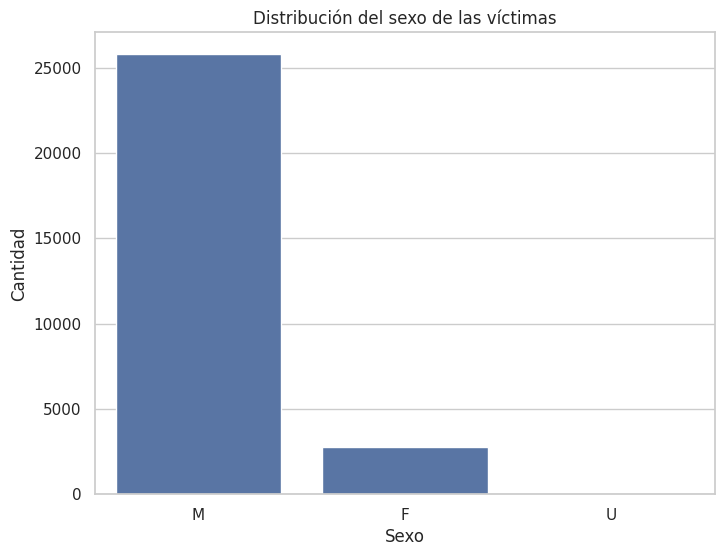

In [20]:
# Contar la frecuencia de cada sexo de las víctimas
sex_counts = df['VIC_SEX'].value_counts()

# Crear un gráfico de barras
plt.figure(figsize=(8, 6))  # Ajustar el tamaño del gráfico si es necesario
sns.countplot(x='VIC_SEX', data=df)
plt.title('Distribución del sexo de las víctimas')
plt.xlabel('Sexo')
plt.ylabel('Cantidad')
plt.show()

Las victimas son más hombres que mujeres en el dataset analizzado siendo M (male)

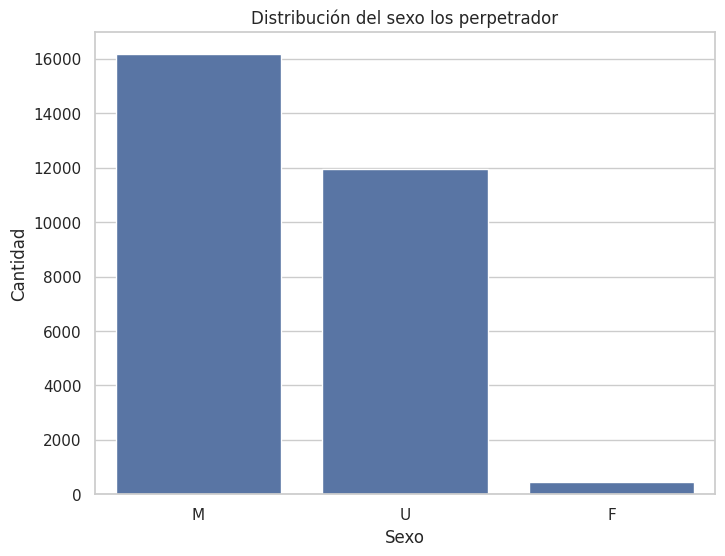

,count
PERP_SEX,
M,16168
U,11950
F,444


In [32]:
# Contar la frecuencia de cada sexo de las víctimas
sex_counts = df['PERP_SEX'].value_counts()

# Crear un gráfico de barras
plt.figure(figsize=(8, 6))  # Ajustar el tamaño del gráfico si es necesario
sns.countplot(x='PERP_SEX', data=df)
plt.title('Distribución del sexo los perpetrador')
plt.xlabel('Sexo')
plt.ylabel('Cantidad')
plt.show()

sex_counts

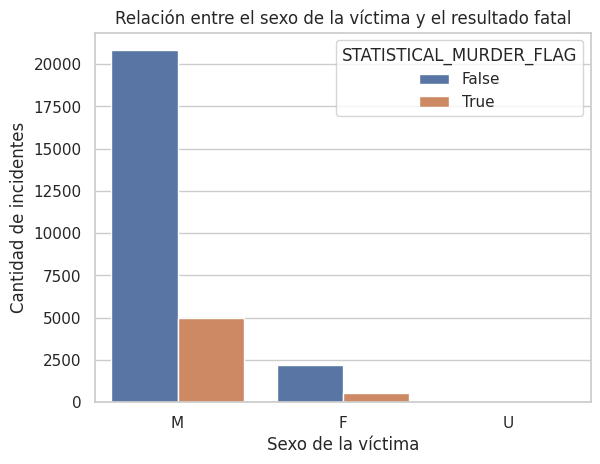

In [33]:
sns.countplot(x='VIC_SEX', hue='STATISTICAL_MURDER_FLAG', data=df)
plt.title('Relación entre el sexo de la víctima y el resultado fatal')
plt.xlabel('Sexo de la víctima')
plt.ylabel('Cantidad de incidentes')
plt.show()

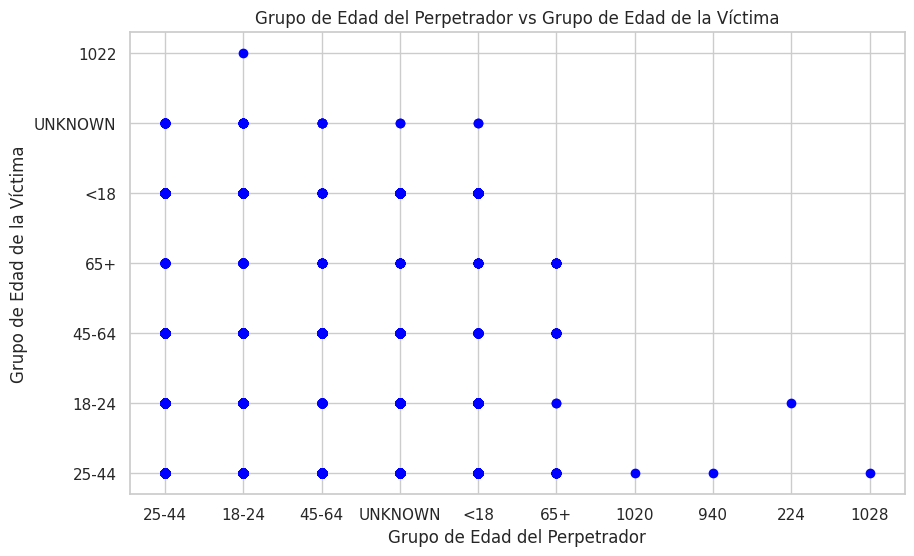

In [34]:


#análisis y gráfico para dos variables: PERP_AGE_GROUP y VIC_AGE_GROUP
plt.figure(figsize=(10,6))

plt.scatter(df['PERP_AGE_GROUP'].astype(str), df['VIC_AGE_GROUP'].astype(str), color='blue')
plt.title('Grupo de Edad del Perpetrador vs Grupo de Edad de la Víctima')
plt.xlabel('Grupo de Edad del Perpetrador')
plt.ylabel('Grupo de Edad de la Víctima')
plt.grid(True)
plt.show()

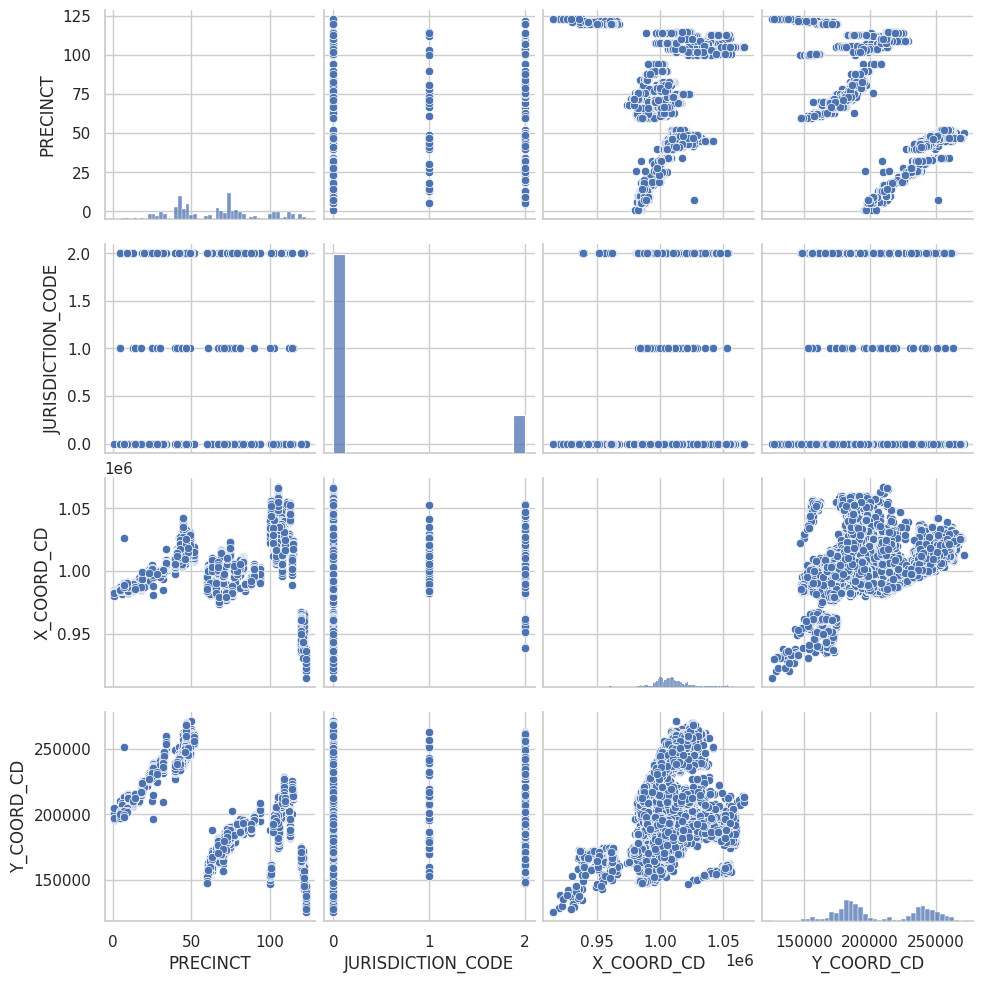

In [36]:
# Grafico de pares
sns.pairplot(df[['PRECINCT', 'JURISDICTION_CODE', 'X_COORD_CD', 'Y_COORD_CD']])
plt.show()

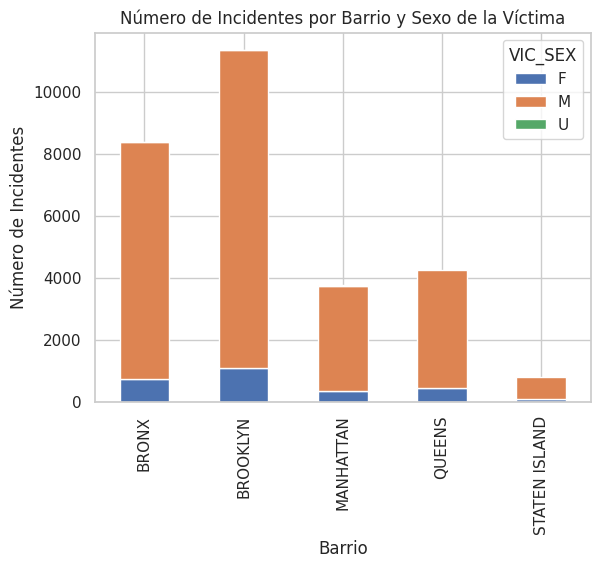

In [37]:
# Gráfico de barras agrupadas para BORO y Sexo de la Victima
df_grouped = df.groupby(['BORO', 'VIC_SEX']).size().unstack()
df_grouped.plot(kind='bar', stacked=True)
plt.title('Número de Incidentes por Barrio y Sexo de la Víctima')
plt.xlabel('Barrio')
plt.ylabel('Número de Incidentes')
plt.show()


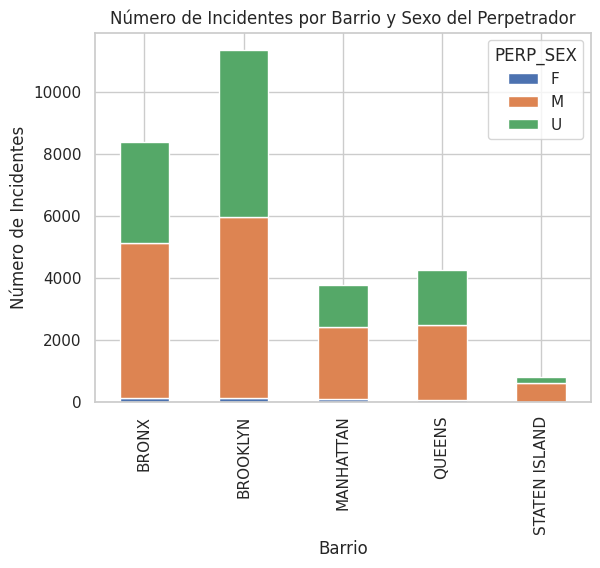

In [38]:
# Gráfico de barras agrupadas para BORO y Sexo de la victima
df_grouped = df.groupby(['BORO',  'PERP_SEX']).size().unstack()
df_grouped.plot(kind='bar', stacked=True)
plt.title('Número de Incidentes por Barrio y Sexo del Perpetrador')
plt.xlabel('Barrio')
plt.ylabel('Número de Incidentes')
plt.show()


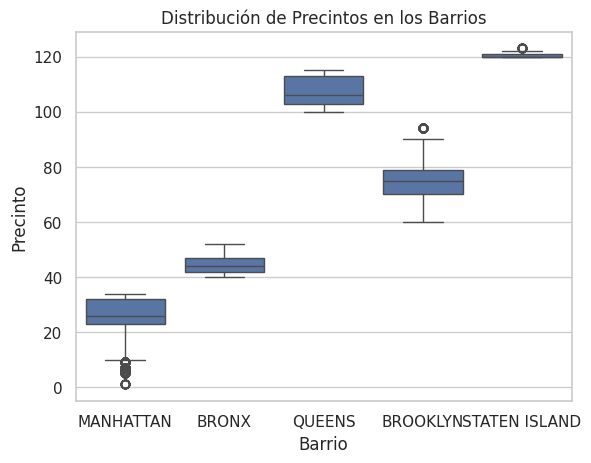

In [39]:
# Gráfico de caja para PRECINCT en diferentes BORO
sns.boxplot(x='BORO', y='PRECINCT', data=df)
plt.title('Distribución de Precintos en los Barrios')
plt.xlabel('Barrio')
plt.ylabel('Precinto')
plt.show()


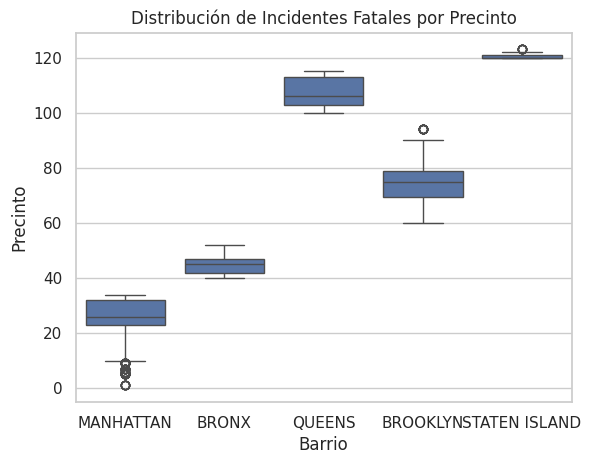

In [40]:

# Filtrar por la variable STATISTICAL_MURDER_FLAG que es True
df_filtered = df[df['STATISTICAL_MURDER_FLAG'] == True]

# Gráfico de caja para PRECINCT en diferentes BORO filtrando por STATISTICAL_MURDER_FLAG True
sns.boxplot(x='BORO', y='PRECINCT', data=df_filtered)
plt.title('Distribución de Incidentes Fatales por Precinto')
plt.xlabel('Barrio')
plt.ylabel('Precinto')
plt.show()


#Acontinuación un analisis de los incidentes fatales

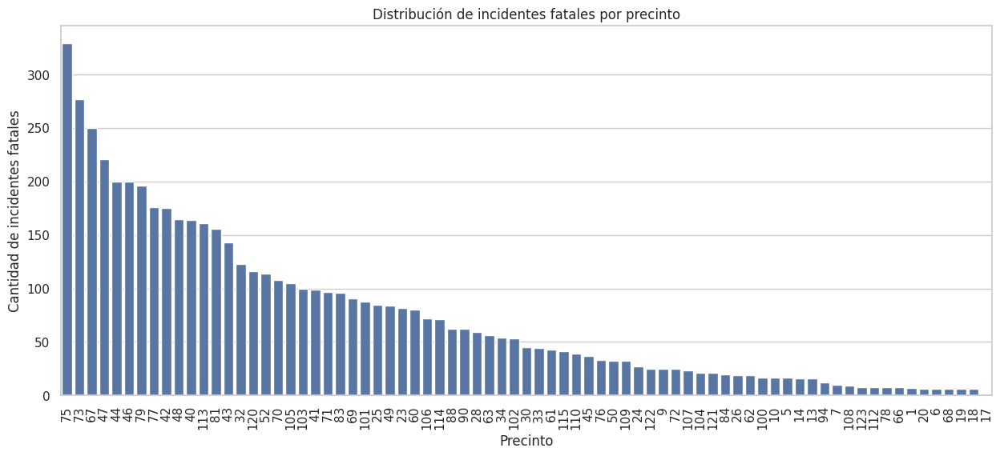

In [64]:
# Filtrar el DataFrame para incluir solo incidentes fatales
incidentes_fatales = df[df['STATISTICAL_MURDER_FLAG'] == True]

# Crear un gráfico de barras que muestre la distribución de incidentes fatales por precinto
plt.figure(figsize=(15, 6))  # Ajustar el tamaño del gráfico si es necesario
sns.countplot(x='PRECINCT', data=incidentes_fatales, order=incidentes_fatales['PRECINCT'].value_counts().index)
plt.title('Distribución de incidentes fatales por precinto')
plt.xlabel('Precinto')
plt.ylabel('Cantidad de incidentes fatales')
plt.xticks(rotation=90)  # Rotar las etiquetas del eje x para una mejor legibilidad
plt.show()

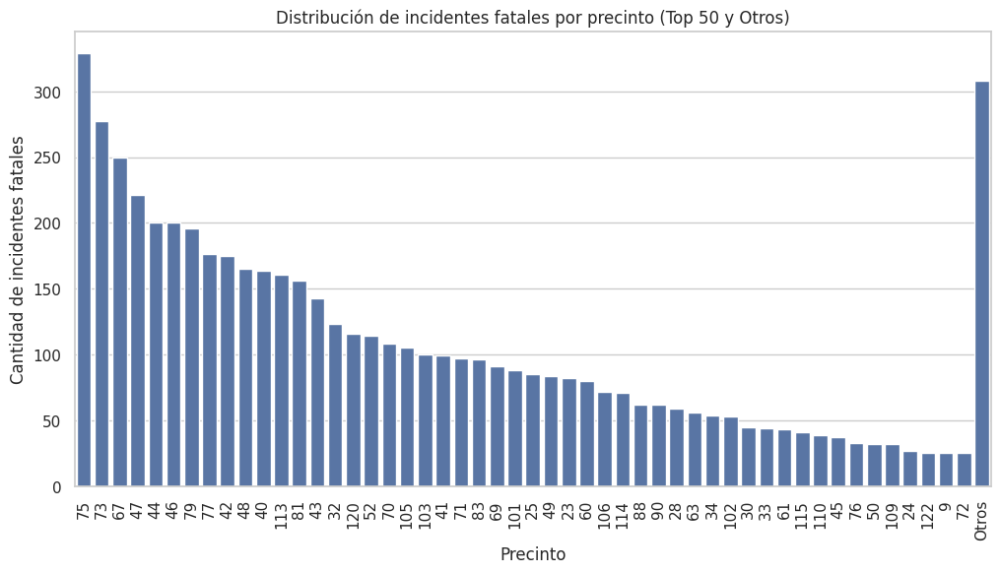

In [65]:

# Contar la cantidad de incidentes fatales por precinto
incidentes_por_precinto = incidentes_fatales['PRECINCT'].value_counts()

# Obtener los top 50 precintos con más incidentes fatales
top_50_precintos = incidentes_por_precinto.nlargest(50)

# Sumar el resto de los incidentes fatales fuera del top 50
resto_incidentes = incidentes_por_precinto.iloc[50:].sum()

# Crear un nuevo DataFrame para el gráfico
top_50_df = pd.concat([top_50_precintos, pd.Series(resto_incidentes, index=['Otros'])])

# Crear un gráfico de barras que muestre la distribución de incidentes fatales por precinto
plt.figure(figsize=(12, 6))  # Ajustar el tamaño del gráfico si es necesario
sns.barplot(x=top_50_df.index, y=top_50_df.values)
plt.title('Distribución de incidentes fatales por precinto (Top 50 y Otros)')
plt.xlabel('Precinto')
plt.ylabel('Cantidad de incidentes fatales')
plt.xticks(rotation=90)  # Rotar las etiquetas del eje x para una mejor legibilidad
plt.show()

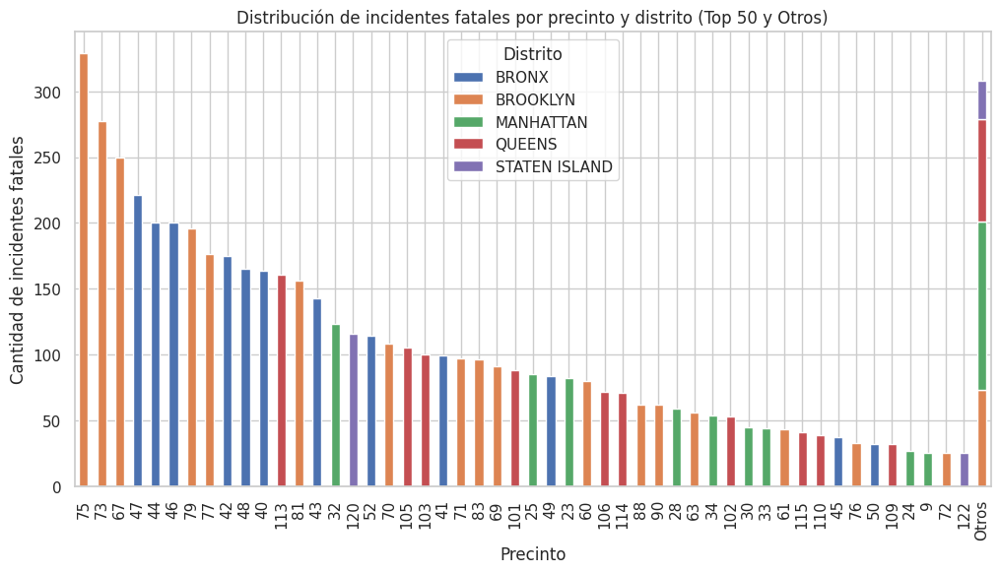

In [66]:

# Contar la cantidad de incidentes fatales por precinto y distrito
incidentes_por_precinto_distrito = incidentes_fatales.groupby(['PRECINCT', 'BORO']).size().unstack(fill_value=0)

# Obtener los top 60 precintos con más incidentes fatales
top_50_precintos = incidentes_por_precinto_distrito.sum(axis=1).nlargest(50).index

# Filtrar el DataFrame para incluir solo los top 50 precintos
incidentes_top_50 = incidentes_por_precinto_distrito.loc[top_50_precintos]

# Sumar el resto de los incidentes fatales fuera del top 50
resto_incidentes = incidentes_por_precinto_distrito.drop(top_50_precintos).sum(axis=0)
incidentes_top_50.loc['Otros'] = resto_incidentes

# Crear un gráfico de barras apiladas que muestre la distribución de incidentes fatales por precinto y distrito
incidentes_top_50.plot(kind='bar', stacked=True, figsize=(12, 6))
plt.title('Distribución de incidentes fatales por precinto y distrito (Top 50 y Otros)')
plt.xlabel('Precinto')
plt.ylabel('Cantidad de incidentes fatales')
plt.xticks(rotation=90)  # Rotar las etiquetas del eje x para una mejor legibilidad
plt.legend(title='Distrito')
plt.show()

En este ultimo grafico es similar al anterior pero podemos distinguir con colores identificatorios los Distritos

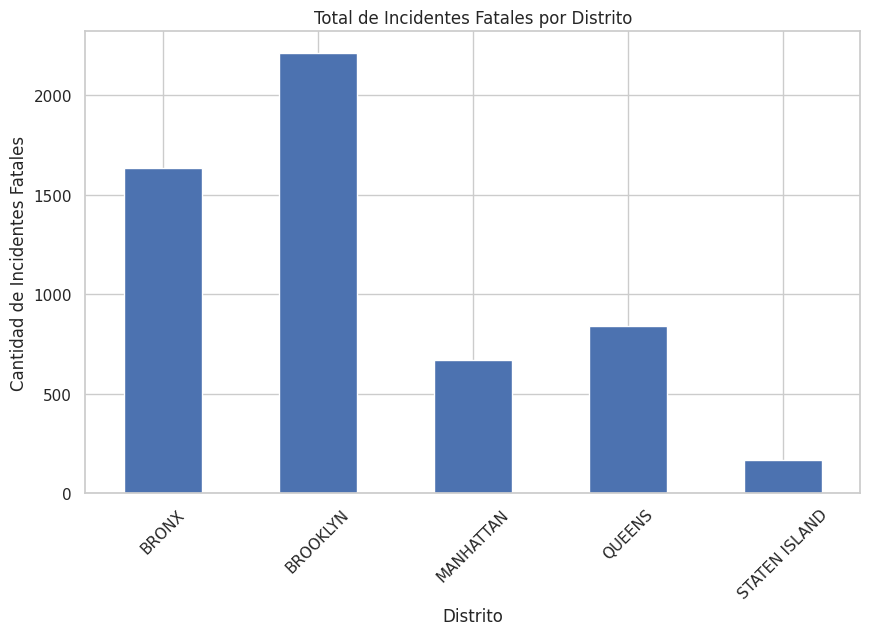

In [44]:
# Contar la cantidad de incidentes fatales por distrito
incidentes_por_distrito = incidentes_fatales.groupby('BORO').size()

# Crear un gráfico de barras que muestre el total de incidentes fatales por distrito
incidentes_por_distrito.plot(kind='bar', figsize=(10, 6))
plt.title('Total de Incidentes Fatales por Distrito')
plt.xlabel('Distrito')
plt.ylabel('Cantidad de Incidentes Fatales')
plt.xticks(rotation=45)  # Rotar las etiquetas del eje x para una mejor legibilidad
plt.show()


In [3]:


!pip install pandas numpy scikit-learn folium geopandas
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
import folium

In [42]:
# Crear un mapa centrado en una ubicación específica
m = folium.Map(location=[df['Latitude'].mean(), df['Longitude'].mean()], zoom_start=12)

for idx, row in df.iterrows():
    color = 'red' if row['STATISTICAL_MURDER_FLAG'] else 'green'
    folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius=2, color=color).add_to(m)

m

En este grafico vemos la ubicacion de todos los incidentes que involucraron intercambio de balas con NYPD donde los circulos verdes no involucran bajas fatales y los de circulos rojos si.

In [68]:
df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,Y_COORD_CD,Latitude,Longitude,Lon_Lat,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek
0,244608249,2022-05-05,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692),2022,5,5,0,10,3
1,247542571,2022-07-04,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,MULTI DWELL - PUBLIC HOUS,True,...,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402),2022,7,4,22,20,0
2,84967535,2012-05-27,19:35:00,QUEENS,OUTSIDE,103,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007),2012,5,27,19,35,6
3,202853370,2019-09-24,21:00:00,BRONX,OUTSIDE,42,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075),2019,9,24,21,0,1
4,27078636,2007-02-25,21:00:00,BROOKLYN,OUTSIDE,83,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004),2007,2,25,21,0,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,2023-03-19,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785),2023,3,19,23,48,6
28558,272968931,2023-08-16,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549),2023,8,16,2,46,2
28559,270489846,2023-06-27,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404),2023,6,27,12,27,1
28560,271021661,2023-07-08,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717),2023,7,8,11,27,5


In [69]:
df.describe(include=['object']).T

,count,unique,top,freq
OCCUR_TIME,28562,1423,23:30:00,185
BORO,28562,5,BROOKLYN,11346
LOC_OF_OCCUR_DESC,28562,2,OUTSIDE,28102
LOC_CLASSFCTN_DESC,28562,9,STREET,27484
LOCATION_DESC,28562,39,MULTI DWELL - PUBLIC HOUS,21695
PERP_AGE_GROUP,28562,10,18-24,16923
PERP_SEX,28562,3,M,16168
PERP_RACE,28562,7,BLACK,22354
VIC_AGE_GROUP,28562,7,25-44,12973
VIC_SEX,28562,3,M,25790


Guardo data frame

In [29]:
# Cargar un CSV de GitHub
url='https://raw.githubusercontent.com/sertuxito/Data-Cience-II/refs/heads/main/DataFrameShootingNYPDLimpio.csv'
df_sinNulos=pd.read_csv(url,sep=',',header=0)
df_sinNulos

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,Latitude,Longitude,Lon_Lat,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek,dist_min_fatalShooting
0,244608249,2022-05-05,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,40.754692,-73.993500,POINT (-73.9935 40.754692),2022,5,5,0,10,3,0.001901
1,247542571,2022-07-04,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,MULTI DWELL - PUBLIC HOUS,True,...,40.854402,-73.882330,POINT (-73.88233 40.854402),2022,7,4,22,20,0,0.000904
2,84967535,2012-05-27,19:35:00,QUEENS,OUTSIDE,103,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007),2012,5,27,19,35,6,0.001157
3,202853370,2019-09-24,21:00:00,BRONX,OUTSIDE,42,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075),2019,9,24,21,0,1,0.001033
4,27078636,2007-02-25,21:00:00,BROOKLYN,OUTSIDE,83,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004),2007,2,25,21,0,6,0.001729
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,2023-03-19,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,40.903785,-73.850098,POINT (-73.850098 40.903785),2023,3,19,23,48,6,0.000008
28558,272968931,2023-08-16,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,40.825549,-73.890195,POINT (-73.890195 40.825549),2023,8,16,2,46,2,0.000014
28559,270489846,2023-06-27,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,40.821404,-73.898938,POINT (-73.898938 40.821404),2023,6,27,12,27,1,0.001559
28560,271021661,2023-07-08,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,40.695717,-73.839138,POINT (-73.839138 40.695717),2023,7,8,11,27,5,0.000896


,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,Y_COORD_CD,Latitude,Longitude,Lon_Lat,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek
0,244608249,2022-05-05,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692),2022,5,5,0,10,3
1,247542571,2022-07-04,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,MULTI DWELL - PUBLIC HOUS,True,...,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402),2022,7,4,22,20,0
2,84967535,2012-05-27,19:35:00,QUEENS,OUTSIDE,103,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007),2012,5,27,19,35,6
3,202853370,2019-09-24,21:00:00,BRONX,OUTSIDE,42,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075),2019,9,24,21,0,1
4,27078636,2007-02-25,21:00:00,BROOKLYN,OUTSIDE,83,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004),2007,2,25,21,0,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,2023-03-19,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785),2023,3,19,23,48,6
28558,272968931,2023-08-16,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549),2023,8,16,2,46,2
28559,270489846,2023-06-27,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404),2023,6,27,12,27,1
28560,271021661,2023-07-08,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717),2023,7,8,11,27,5


In [30]:
# Lista de columnas a eliminar
columns_to_delete = ['OCCUR_DATE', 'OCCUR_TIME', 'LOC_OF_OCCUR_DESC', 'JURISDICTION_CODE',
                   'LOCATION_DESC', 'LOC_CLASSFCTN_DESC',
                     'PERP_RACE', 'VIC_SEX','PERP_AGE_GROUP','Lon_Lat','X_COORD_CD','Y_COORD_CD']

# Eliminar las columnas especificadas
df_sinNulos.drop(columns=columns_to_delete, inplace=True)


In [31]:
df=df_sinNulos
df

,INCIDENT_KEY,BORO,PRECINCT,STATISTICAL_MURDER_FLAG,PERP_SEX,VIC_AGE_GROUP,VIC_RACE,Latitude,Longitude,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek,dist_min_fatalShooting
0,244608249,MANHATTAN,14,True,M,25-44,BLACK,40.754692,-73.993500,2022,5,5,0,10,3,0.001901
1,247542571,BRONX,48,True,U,18-24,BLACK,40.854402,-73.882330,2022,7,4,22,20,0,0.000904
2,84967535,QUEENS,103,False,U,18-24,BLACK,40.710634,-73.767773,2012,5,27,19,35,6,0.001157
3,202853370,BRONX,42,False,M,25-44,BLACK,40.832417,-73.890714,2019,9,24,21,0,1,0.001033
4,27078636,BROOKLYN,83,False,M,25-44,BLACK,40.688443,-73.910219,2007,2,25,21,0,6,0.001729
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,BRONX,47,True,M,18-24,BLACK,40.903785,-73.850098,2023,3,19,23,48,6,0.000008
28558,272968931,BRONX,41,False,F,45-64,BLACK,40.825549,-73.890195,2023,8,16,2,46,2,0.000014
28559,270489846,BRONX,41,True,M,25-44,BLACK,40.821404,-73.898938,2023,6,27,12,27,1,0.001559
28560,271021661,QUEENS,102,False,M,65+,ASIAN / PACIFIC ISLANDER,40.695717,-73.839138,2023,7,8,11,27,5,0.000896


In [37]:
df2=df
df2

,INCIDENT_KEY,PRECINCT,STATISTICAL_MURDER_FLAG,Latitude,Longitude,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,...,VIC_AGE_GROUP_45-64,VIC_AGE_GROUP_65+,VIC_AGE_GROUP_<18,VIC_AGE_GROUP_UNKNOWN,VIC_RACE_ASIAN / PACIFIC ISLANDER,VIC_RACE_BLACK,VIC_RACE_BLACK HISPANIC,VIC_RACE_UNKNOWN,VIC_RACE_WHITE,VIC_RACE_WHITE HISPANIC
0,244608249,14,True,40.754692,-73.993500,2022,5,5,0,10,...,False,False,False,False,False,True,False,False,False,False
1,247542571,48,True,40.854402,-73.882330,2022,7,4,22,20,...,False,False,False,False,False,True,False,False,False,False
2,84967535,103,False,40.710634,-73.767773,2012,5,27,19,35,...,False,False,False,False,False,True,False,False,False,False
3,202853370,42,False,40.832417,-73.890714,2019,9,24,21,0,...,False,False,False,False,False,True,False,False,False,False
4,27078636,83,False,40.688443,-73.910219,2007,2,25,21,0,...,False,False,False,False,False,True,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,47,True,40.903785,-73.850098,2023,3,19,23,48,...,False,False,False,False,False,True,False,False,False,False
28558,272968931,41,False,40.825549,-73.890195,2023,8,16,2,46,...,True,False,False,False,False,True,False,False,False,False
28559,270489846,41,True,40.821404,-73.898938,2023,6,27,12,27,...,False,False,False,False,False,True,False,False,False,False
28560,271021661,102,False,40.695717,-73.839138,2023,7,8,11,27,...,False,True,False,False,True,False,False,False,False,False


In [32]:
df_sinNulos


,INCIDENT_KEY,BORO,PRECINCT,STATISTICAL_MURDER_FLAG,PERP_SEX,VIC_AGE_GROUP,VIC_RACE,Latitude,Longitude,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek,dist_min_fatalShooting
0,244608249,MANHATTAN,14,True,M,25-44,BLACK,40.754692,-73.993500,2022,5,5,0,10,3,0.001901
1,247542571,BRONX,48,True,U,18-24,BLACK,40.854402,-73.882330,2022,7,4,22,20,0,0.000904
2,84967535,QUEENS,103,False,U,18-24,BLACK,40.710634,-73.767773,2012,5,27,19,35,6,0.001157
3,202853370,BRONX,42,False,M,25-44,BLACK,40.832417,-73.890714,2019,9,24,21,0,1,0.001033
4,27078636,BROOKLYN,83,False,M,25-44,BLACK,40.688443,-73.910219,2007,2,25,21,0,6,0.001729
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,BRONX,47,True,M,18-24,BLACK,40.903785,-73.850098,2023,3,19,23,48,6,0.000008
28558,272968931,BRONX,41,False,F,45-64,BLACK,40.825549,-73.890195,2023,8,16,2,46,2,0.000014
28559,270489846,BRONX,41,True,M,25-44,BLACK,40.821404,-73.898938,2023,6,27,12,27,1,0.001559
28560,271021661,QUEENS,102,False,M,65+,ASIAN / PACIFIC ISLANDER,40.695717,-73.839138,2023,7,8,11,27,5,0.000896


In [33]:
# Convert 'OCCUR_DATE' to numeric features before one-hot encoding
# Convert 'OCCUR_DATE' to numeric features before one-hot encoding
#if 'OCCUR_DATE' in df.columns:
    # Convert to datetime objects first, then extract numeric features
 #   df['OCCUR_DATE'] = pd.to_datetime(df['OCCUR_DATE'])
 #   df['OCCUR_DATE_YEAR'] = df['OCCUR_DATE'].dt.year
  #  df['OCCUR_DATE_MONTH'] = df['OCCUR_DATE'].dt.month
 #   df['OCCUR_DATE_DAY'] = df['OCCUR_DATE'].dt.day
    # Optionally, drop the original 'OCCUR_DATE' column
 #   df = df.drop('OCCUR_DATE', axis=1)


# Codificar variables categóricas, excluyendo la columna de fecha
categorical_columns = df.select_dtypes(include=['object']).columns
df = pd.get_dummies(df, columns=categorical_columns, drop_first=True)  # drop_first to avoid multicollinearity


# Separar características y etiquetas
X = df.drop('STATISTICAL_MURDER_FLAG', axis=1)
y = df['STATISTICAL_MURDER_FLAG']

# Dividir el conjunto de datos en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Crear el modelo de Random Forest
model = RandomForestClassifier(n_estimators=100)
# Entrenar el modelo
model.fit(X_train, y_train)

# Realizar predicciones
y_pred = model.predict(X_test)

# Evaluar el modelo
from sklearn.metrics import accuracy_score, classification_report # Make sure these are imported
accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print(f"Classification Report:\n{report}")

Accuracy: 0.7850516366182391
Classification Report:
              precision    recall  f1-score   support

       False       0.82      0.95      0.88      4616
        True       0.31      0.10      0.15      1097

    accuracy                           0.79      5713
   macro avg       0.56      0.52      0.51      5713
weighted avg       0.72      0.79      0.74      5713



In [34]:
!pip install imblearn
from imblearn.over_sampling import SMOTE
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix



In [35]:
# Crear un modelo de Ramdom Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)

# Initialize SMOTE and resample the data
smote = SMOTE(random_state=42)
X_resampled_smote, y_resampled_smote = smote.fit_resample(X_train, y_train)

# Entrenar y evaluar el modelo con sobremuestreo (SMOTE)
model.fit(X_resampled_smote, y_resampled_smote)
y_pred_smote = model.predict(X_test)
accuracy_smote = accuracy_score(y_test, y_pred_smote)

print("Resultados con SMOTE (Sobremuestreo):")
print(classification_report(y_test, y_pred_smote))
print(confusion_matrix(y_test, y_pred_smote))

Resultados con SMOTE (Sobremuestreo):
              precision    recall  f1-score   support

       False       0.82      0.94      0.88      4616
        True       0.33      0.12      0.18      1097

    accuracy                           0.78      5713
   macro avg       0.57      0.53      0.53      5713
weighted avg       0.72      0.78      0.74      5713

[[4343  273]
 [ 963  134]]


Comparación Detallada:

Precisión:

Clase "False":
Antes de SMOTE: 0.82
Después de SMOTE: 0.82

Clase "True":
Antes de SMOTE: 0.31
Después de SMOTE: 0.33

Sensibilidad (Recall):

Clase "False":
Antes de SMOTE: 0.95
Después de SMOTE: 0.94

Clase "True":
Antes de SMOTE: 0.10
Después de SMOTE: 0.12

F1-Score:

Clase "False":
Antes de SMOTE: 0.88
Después de SMOTE: 0.88

Clase "True":
Antes de SMOTE: 0.15
Después de SMOTE: 0.18

Soporte:

Clase "False":
Antes de SMOTE: 4616
Después de SMOTE: 4616

Clase "True":
Antes de SMOTE: 1097
Después de SMOTE: 1097

Exactitud:

Antes de SMOTE: 0.785
Después de SMOTE: 0.78

Promedio Macro:

Precisión:
Antes de SMOTE: 0.56
Después de SMOTE: 0.57

Sensibilidad (Recall):
Antes de SMOTE: 0.52
Después de SMOTE: 0.53

F1-Score:
Antes de SMOTE: 0.51
Después de SMOTE: 0.53

Promedio Ponderado:

Precisión:
Antes de SMOTE: 0.72
Después de SMOTE: 0.72

Sensibilidad (Recall):
Antes de SMOTE: 0.79
Después de SMOTE: 0.78

F1-Score:
Antes de SMOTE: 0.74
Después de SMOTE: 0.74

Conclusión:
Clase "False": El rendimiento del modelo es consistente y alto en términos de precisión, sensibilidad y F1-Score, tanto antes como después de aplicar SMOTE.

Clase "True": Aunque las métricas mejoran ligeramente después de aplicar SMOTE, el rendimiento sigue siendo bajo, especialmente en términos de sensibilidad y F1-Score.

Exactitud General: La exactitud general del modelo se mantiene prácticamente igual, lo que indica que SMOTE no ha tenido un impacto significativo en el rendimiento global del modelo.

Promedio Macro y Ponderado: Las métricas promedio muestran una ligera mejora después de aplicar SMOTE, pero no lo suficiente como para cambiar significativamente la interpretación del rendimiento del modelo.

#Otro Enfoque
Distacias entre las posiciones
Intentare otro enfoque pensando en la distancia de las coordenadas entre si.... Y la distancia al punto más cercano donde hubo una baja humana

In [38]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from scipy.spatial import distance_matrix


#  Genero una matriz de distancias entre las coordenadas del dataset
coords = df2[['Latitude', 'Longitude']].to_numpy()
dist_matrix = distance_matrix(coords, coords)


In [85]:
dist_matrix

array([[0.        , 0.1493347 , 0.22998598, ..., 0.11572581, 0.1652443 ,
        0.06251005],
       [0.1493347 , 0.        , 0.18382708, ..., 0.03694176, 0.16445813,
        0.08725013],
       [0.22998598, 0.18382708, 0.        , ..., 0.17168021, 0.07290688,
        0.20391406],
       ...,
       [0.11572581, 0.03694176, 0.17168021, ..., 0.        , 0.13918787,
        0.05601132],
       [0.1652443 , 0.16445813, 0.07290688, ..., 0.13918787, 0.        ,
        0.15310871],
       [0.06251005, 0.08725013, 0.20391406, ..., 0.05601132, 0.15310871,
        0.        ]], shape=(28562, 28562))

In [39]:
# Características basadas en distancia

df2['dist_min_fatalShooting'] = [
    min(dist_matrix[i][df2['STATISTICAL_MURDER_FLAG']][dist_matrix[i][df2['STATISTICAL_MURDER_FLAG'] ] > 0])
    if any(df2['STATISTICAL_MURDER_FLAG'] ) else np.inf
    for i in range(len(df2))
]

df2

,INCIDENT_KEY,PRECINCT,STATISTICAL_MURDER_FLAG,Latitude,Longitude,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,...,VIC_AGE_GROUP_45-64,VIC_AGE_GROUP_65+,VIC_AGE_GROUP_<18,VIC_AGE_GROUP_UNKNOWN,VIC_RACE_ASIAN / PACIFIC ISLANDER,VIC_RACE_BLACK,VIC_RACE_BLACK HISPANIC,VIC_RACE_UNKNOWN,VIC_RACE_WHITE,VIC_RACE_WHITE HISPANIC
0,244608249,14,True,40.754692,-73.993500,2022,5,5,0,10,...,False,False,False,False,False,True,False,False,False,False
1,247542571,48,True,40.854402,-73.882330,2022,7,4,22,20,...,False,False,False,False,False,True,False,False,False,False
2,84967535,103,False,40.710634,-73.767773,2012,5,27,19,35,...,False,False,False,False,False,True,False,False,False,False
3,202853370,42,False,40.832417,-73.890714,2019,9,24,21,0,...,False,False,False,False,False,True,False,False,False,False
4,27078636,83,False,40.688443,-73.910219,2007,2,25,21,0,...,False,False,False,False,False,True,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,47,True,40.903785,-73.850098,2023,3,19,23,48,...,False,False,False,False,False,True,False,False,False,False
28558,272968931,41,False,40.825549,-73.890195,2023,8,16,2,46,...,True,False,False,False,False,True,False,False,False,False
28559,270489846,41,True,40.821404,-73.898938,2023,6,27,12,27,...,False,False,False,False,False,True,False,False,False,False
28560,271021661,102,False,40.695717,-73.839138,2023,7,8,11,27,...,False,True,False,False,True,False,False,False,False,False



El nuevo dataset obtenido contiene una posición si corresponde o no a un evento que derivo en una muerte y la distacia minima a otro evento donde efectivamente derivo en muerte.

In [40]:
# Dividir en datos de entrenamiento y prueba
X = df2[['dist_min_fatalShooting']]
y = df2['STATISTICAL_MURDER_FLAG']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Entrenar un modelo de clasificación
model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)

# Predicciones
y_pred = model.predict(X_test)

# Evaluar el modelo
from sklearn.metrics import accuracy_score, classification_report # Make sure these are imported
accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy_score(y_test, y_pred):.2f}")
print(f"Classification Report:\n{report}")

Accuracy: 0.77
Classification Report:
              precision    recall  f1-score   support

       False       0.84      0.88      0.86      4616
        True       0.37      0.30      0.33      1097

    accuracy                           0.77      5713
   macro avg       0.61      0.59      0.60      5713
weighted avg       0.75      0.77      0.76      5713



En este nuevo enfoque donde calculamos la distacia minima a un incidente con final fatal el modelo mejoro la precision aunque sigue siendo bajo la mejora fue considrable, La precisión para la clase "True" en el enfoque anterior dio resultados (0.31) y (0.33) con SMOTE.  En este nuevo enfoque generando la variave adicional calculada con la distancia minima a otro punto de incidente fatal eleva la precision a (0.37)

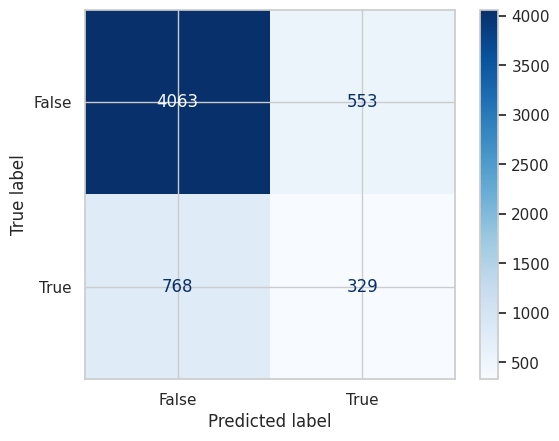

In [41]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Calcular la matriz de confusión
cm = confusion_matrix(y_test, y_pred)

# Visualizar la matriz de confusión
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=model.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.show()

In [42]:
print(cm)

[[4063  553]
 [ 768  329]]


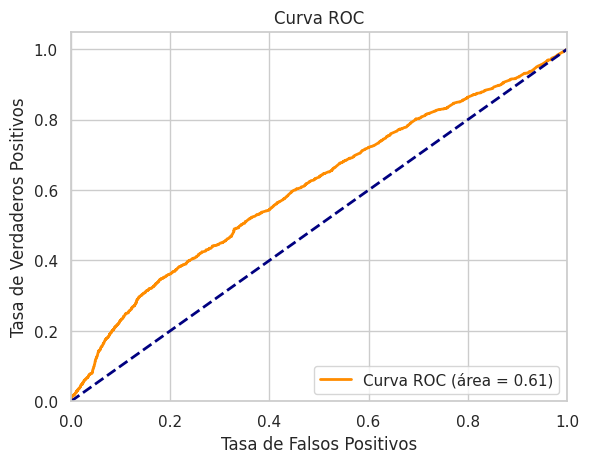

In [43]:
# Importar roc_curve y auc desde sklearn.metrics
from sklearn.metrics import roc_curve, auc

# Codificar variables categóricas
df2 = pd.get_dummies(df2)

# Separar características y etiquetas
X = df2.drop('STATISTICAL_MURDER_FLAG', axis=1)
y = df2['STATISTICAL_MURDER_FLAG']

# Dividir el conjunto de datos en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Crear el modelo de Random Forest
model = RandomForestClassifier(n_estimators=100)

# Entrenar el modelo
model.fit(X_train, y_train)

# Realizar predicciones de probabilidad
y_prob = model.predict_proba(X_test)[:, 1]

# Calcular la curva ROC y el AUC
fpr, tpr, thresholds = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)

# Graficar la curva ROC
plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2, label='Curva ROC (área = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Tasa de Falsos Positivos')
plt.ylabel('Tasa de Verdaderos Positivos')
plt.title('Curva ROC')
plt.legend(loc="lower right")
plt.show()


In [44]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from scipy.stats import randint

# Definir el modelo
model = RandomForestClassifier()

# Definir los hiperparámetros a ajustar
param_dist = {
    'n_estimators': randint(50, 200),
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': randint(2, 11),
    'min_samples_leaf': randint(1, 5)
}

# Configurar Random Search
random_search = RandomizedSearchCV(estimator=model, param_distributions=param_dist, n_iter=100, cv=5, n_jobs=-1, verbose=2, random_state=42)

# Ajustar el modelo
random_search.fit(X_train, y_train)

# Obtener los mejores hiperparámetros
best_params = random_search.best_params_
print(f"Mejores hiperparámetros: {best_params}")

# Evaluar el modelo con los mejores hiperparámetros
best_model = random_search.best_estimator_
y_pred = best_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print(f"Classification Report:\n{report}")


Fitting 5 folds for each of 100 candidates, totalling 500 fits
Mejores hiperparámetros: {'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 4, 'n_estimators': 57}
Accuracy: 0.8058116466332127
Classification Report:
              precision    recall  f1-score   support

       False       0.81      1.00      0.89      6908
        True       0.36      0.00      0.00      1661

    accuracy                           0.81      8569
   macro avg       0.59      0.50      0.45      8569
weighted avg       0.72      0.81      0.72      8569



Mejores Hiperparámetros:

max_depth: 10
min_samples_leaf: 1
min_samples_split: 4
n_estimators: 57

Exactitud:

La exactitud del modelo es 0.8058, lo que indica que el modelo clasifica correctamente aproximadamente el 80.58% de las instancias.

Informe de Clasificación:

Clase "False":

Precisión: 0.81
Sensibilidad (Recall): 1.00
F1-Score: 0.89
Soporte: 6908

Clase "True":

Precisión: 0.36

Sensibilidad (Recall): 0.00

F1-Score: 0.00

Soporte: 1661


Promedio Macro:

Precisión: 0.59
Sensibilidad (Recall): 0.50
F1-Score: 0.45

Promedio Ponderado:

Precisión: 0.72
Sensibilidad (Recall): 0.81
F1-Score: 0.72


Interpretación:

Clase "False": El modelo tiene un rendimiento excelente para la clase "False", con una precisión y sensibilidad muy altas, lo que significa que casi todos los casos negativos se clasifican correctamente.

Clase "True": El rendimiento del modelo para la clase "True" es muy bajo, con una precisión baja y una sensibilidad de 0. Esto indica que el modelo no está capturando correctamente los casos positivos.

Exactitud General: La exactitud general del modelo es buena, pero esto se debe principalmente al buen rendimiento en la clase mayoritaria ("False").

Promedio Macro y Ponderado: Las métricas promedio muestran un desequilibrio en el rendimiento del modelo entre las dos clases, con un rendimiento significativamente mejor para la clase "False".


Conclusión General:
El modelo tiene un rendimiento desequilibrado, con un excelente rendimiento para la clase "False" pero un rendimiento muy pobre para la clase "True". Esto sugiere que el modelo puede estar sesgado hacia la clase mayoritaria y no está manejando bien la clase minoritaria. Podría ser necesario ajustar el modelo o aplicar técnicas adicionales para mejorar el rendimiento en la clase "True".

In [ ]:
# Guardar el DataFrame en un archivo CSV
#df.to_csv('df.csv', index=False)
#from google.colab import files

# Descargar el archivo CSV
#files.download('df.csv')


In [58]:
# Cargar un CSV de GitHub
url='https://raw.githubusercontent.com/sertuxito/Data-Cience-II/refs/heads/main/DataFrameShootingNYPDLimpio.csv'
df_sinNulos=pd.read_csv(url,sep=',',header=0)
df_sinNulos

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,Latitude,Longitude,Lon_Lat,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek,dist_min_fatalShooting
0,244608249,2022-05-05,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,40.754692,-73.993500,POINT (-73.9935 40.754692),2022,5,5,0,10,3,0.001901
1,247542571,2022-07-04,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,MULTI DWELL - PUBLIC HOUS,True,...,40.854402,-73.882330,POINT (-73.88233 40.854402),2022,7,4,22,20,0,0.000904
2,84967535,2012-05-27,19:35:00,QUEENS,OUTSIDE,103,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007),2012,5,27,19,35,6,0.001157
3,202853370,2019-09-24,21:00:00,BRONX,OUTSIDE,42,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075),2019,9,24,21,0,1,0.001033
4,27078636,2007-02-25,21:00:00,BROOKLYN,OUTSIDE,83,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004),2007,2,25,21,0,6,0.001729
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,2023-03-19,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,40.903785,-73.850098,POINT (-73.850098 40.903785),2023,3,19,23,48,6,0.000008
28558,272968931,2023-08-16,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,MULTI DWELL - PUBLIC HOUS,False,...,40.825549,-73.890195,POINT (-73.890195 40.825549),2023,8,16,2,46,2,0.000014
28559,270489846,2023-06-27,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,40.821404,-73.898938,POINT (-73.898938 40.821404),2023,6,27,12,27,1,0.001559
28560,271021661,2023-07-08,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,40.695717,-73.839138,POINT (-73.839138 40.695717),2023,7,8,11,27,5,0.000896


In [59]:
# Lista de columnas a eliminar
columns_to_delete = ['OCCUR_DATE', 'OCCUR_TIME', 'LOC_OF_OCCUR_DESC', 'JURISDICTION_CODE',
                   'LOCATION_DESC', 'LOC_CLASSFCTN_DESC',
                     'PERP_RACE', 'VIC_SEX','PERP_AGE_GROUP','Lon_Lat','X_COORD_CD','Y_COORD_CD']

# Eliminar las columnas especificadas
df_sinNulos.drop(columns=columns_to_delete, inplace=True)


In [60]:
df=df_sinNulos
df

,INCIDENT_KEY,BORO,PRECINCT,STATISTICAL_MURDER_FLAG,PERP_SEX,VIC_AGE_GROUP,VIC_RACE,Latitude,Longitude,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek,dist_min_fatalShooting
0,244608249,MANHATTAN,14,True,M,25-44,BLACK,40.754692,-73.993500,2022,5,5,0,10,3,0.001901
1,247542571,BRONX,48,True,U,18-24,BLACK,40.854402,-73.882330,2022,7,4,22,20,0,0.000904
2,84967535,QUEENS,103,False,U,18-24,BLACK,40.710634,-73.767773,2012,5,27,19,35,6,0.001157
3,202853370,BRONX,42,False,M,25-44,BLACK,40.832417,-73.890714,2019,9,24,21,0,1,0.001033
4,27078636,BROOKLYN,83,False,M,25-44,BLACK,40.688443,-73.910219,2007,2,25,21,0,6,0.001729
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,BRONX,47,True,M,18-24,BLACK,40.903785,-73.850098,2023,3,19,23,48,6,0.000008
28558,272968931,BRONX,41,False,F,45-64,BLACK,40.825549,-73.890195,2023,8,16,2,46,2,0.000014
28559,270489846,BRONX,41,True,M,25-44,BLACK,40.821404,-73.898938,2023,6,27,12,27,1,0.001559
28560,271021661,QUEENS,102,False,M,65+,ASIAN / PACIFIC ISLANDER,40.695717,-73.839138,2023,7,8,11,27,5,0.000896


#Nuevo enfoque Klusterizacion  Aprendizaje no supervisado

Canbiando de enfoque buscando agrupar geolocalizaciones propensas a muertes fatales en un shooting con NYPD

In [61]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

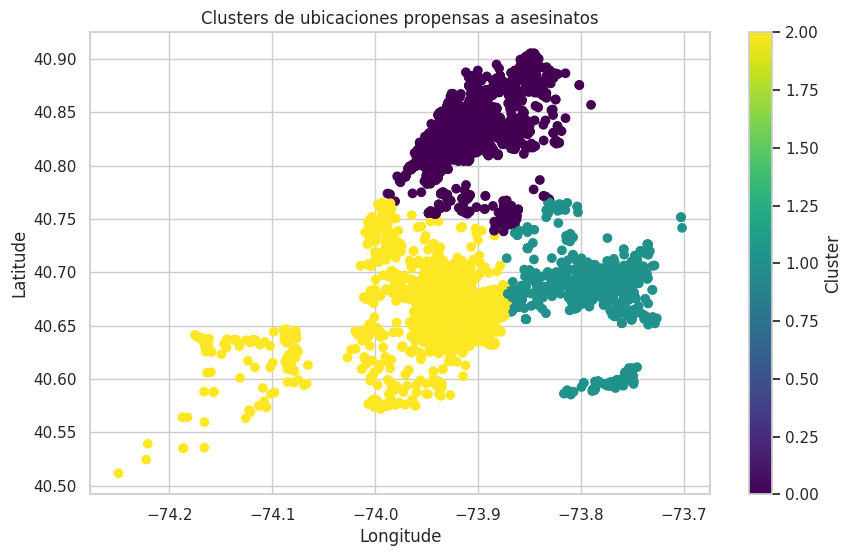

In [62]:
# Filtrar solo las ubicaciones con murderFlag True
df_murder = df[df['STATISTICAL_MURDER_FLAG'] == True]

# Aplicar K-Means
kmeans = KMeans(n_clusters=3, random_state=42)
df_murder['cluster'] = kmeans.fit_predict(df_murder[['Latitude', 'Longitude']])

# Visualizar los resultados
plt.figure(figsize=(10, 6))
plt.scatter(df_murder['Longitude'], df_murder['Latitude'], c=df_murder['cluster'], cmap='viridis', marker='o')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Clusters de ubicaciones propensas a asesinatos')
plt.colorbar(label='Cluster')
plt.show()

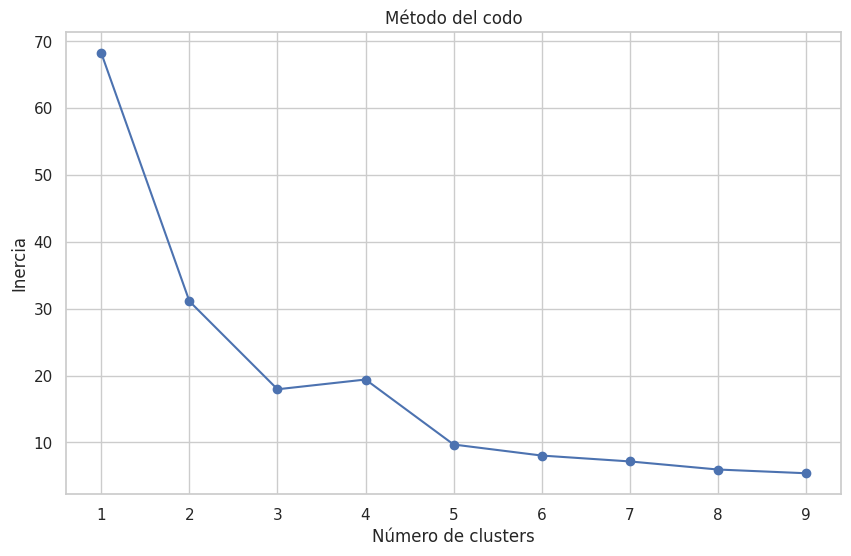

In [63]:
# Calcular la inercia para diferentes números de clusters
inercia = []
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df_murder[['Latitude', 'Longitude']])
    inercia.append(kmeans.inertia_)

# Graficar la inercia
plt.figure(figsize=(10, 6))
plt.plot(range(1, 10), inercia, marker='o') # Changed this line
plt.xlabel('Número de clusters')
plt.ylabel('Inercia')
plt.title('Método del codo')
plt.show()

podemos ver que la cantidad de klusters pueden ser 3 o 5

In [64]:
from sklearn.metrics import silhouette_score

# Calcular el coeficiente de silueta
kmeans = KMeans(n_clusters=3, random_state=42)
labels = kmeans.fit_predict(df_murder[['Latitude', 'Longitude']])
silhouette_avg = silhouette_score(df_murder[['Latitude', 'Longitude']], labels)

print(f"Coeficiente de Silueta: {silhouette_avg:.2f}")

Coeficiente de Silueta: 0.59




Valor Positivo: Un coeficiente de silueta positivo (mayor que 0) indica que, en promedio, los puntos están más cerca de los puntos de su propio clúster que de los puntos de otros clústeres.
Cercano a 1: Un valor cercano a 1 sugiere que los clústeres están bien separados y que los puntos están bien agrupados dentro de sus respectivos clústeres.
Valor de 0.59: Un coeficiente de silueta de 0.59 es bastante bueno. Indica que los clústeres están razonablemente bien definidos y que los puntos están, en general, bien agrupados. Aunque no es perfecto, sugiere que el modelo de k-means ha hecho un buen trabajo al identificar clústeres en los datos.

Interpretación del Coeficiente de Silueta de 0.59:

Un coeficiente de silueta de 0.59 sugiere que los clústeres formados son de buena calidad, con una separación clara entre los diferentes clústeres y una cohesión adecuada dentro de cada clúster. Sin embargo, siempre es útil visualizar los clústeres y considerar otras métricas para obtener una evaluación más completa del rendimiento del modelo.

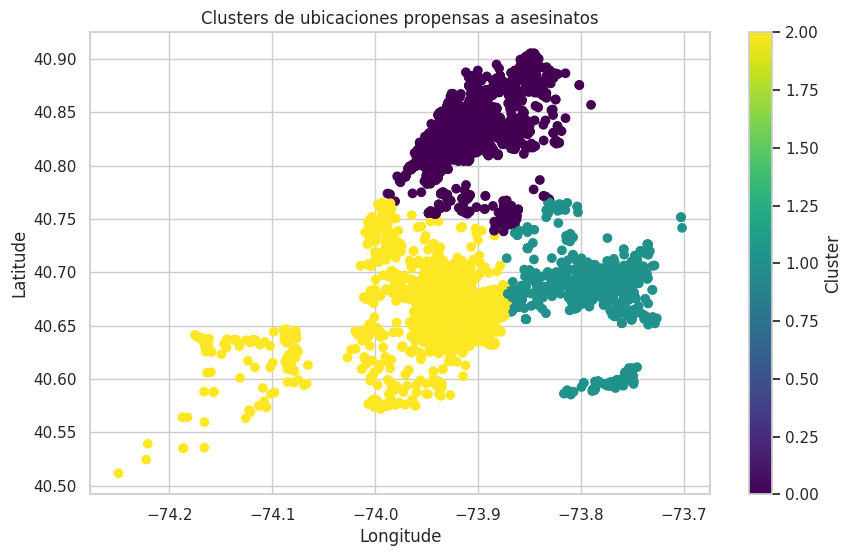

In [65]:
# Visualizar los resultados
plt.figure(figsize=(10, 6))
plt.scatter(df_murder['Longitude'], df_murder['Latitude'], c=df_murder['cluster'], cmap='viridis', marker='o')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Clusters de ubicaciones propensas a asesinatos')
plt.colorbar(label='Cluster')
plt.show()

In [66]:
df_murder

,INCIDENT_KEY,BORO,PRECINCT,STATISTICAL_MURDER_FLAG,PERP_SEX,VIC_AGE_GROUP,VIC_RACE,Latitude,Longitude,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek,dist_min_fatalShooting,cluster
0,244608249,MANHATTAN,14,True,M,25-44,BLACK,40.754692,-73.993500,2022,5,5,0,10,3,0.001901,2
1,247542571,BRONX,48,True,U,18-24,BLACK,40.854402,-73.882330,2022,7,4,22,20,0,0.000904,0
6,229224142,QUEENS,113,True,U,45-64,BLACK,40.673306,-73.789887,2021,6,7,19,55,0,0.001216,1
9,238210279,BRONX,49,True,M,25-44,BLACK,40.860463,-73.865561,2021,12,22,23,17,2,0.001807,0
11,238238212,QUEENS,114,True,U,25-44,BLACK,40.769744,-73.909872,2021,12,23,4,5,3,0.001963,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28544,269679452,BROOKLYN,67,True,M,25-44,BLACK,40.634916,-73.932963,2023,6,10,4,12,5,0.000464,2
28549,276323863,QUEENS,104,True,M,25-44,WHITE,40.700826,-73.881490,2023,10,21,2,44,5,0.006361,2
28551,265744133,BROOKLYN,88,True,U,18-24,BLACK,40.695772,-73.979528,2023,3,27,11,8,0,0.000399,2
28557,265354835,BRONX,47,True,M,18-24,BLACK,40.903785,-73.850098,2023,3,19,23,48,6,0.000008,0


In [67]:
# Crear un mapa centrado en una ubicación específica siendo la media de las latitudes y longotudes
m = folium.Map(location=[df_murder['Latitude'].mean(), df_murder['Longitude'].mean()], zoom_start=11)

for idx, row in df_murder.iterrows():
    if row['cluster'] == 2:
        color = 'red'
    elif row['cluster'] == 1:
        color = 'green'
    else:
        color = 'blue'

    folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius=2, color=color).add_to(m)
m

#Aplicar Modelo  DBSCAN para kusterizar segun densidad

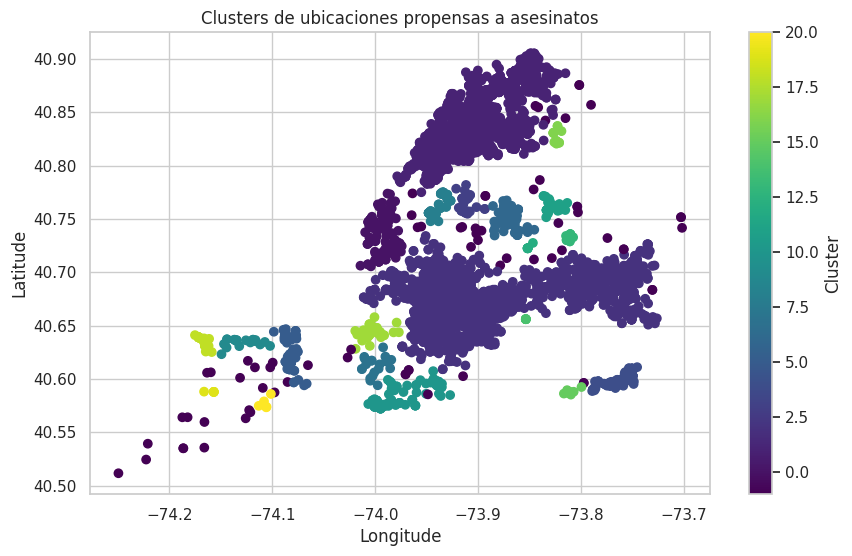

In [68]:
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt

# Filtrar solo las ubicaciones con murderFlag True
df_murder = df[df['STATISTICAL_MURDER_FLAG'] == True]

# Aplicar DBSCAN
dbscan = DBSCAN(eps=0.01, min_samples=5)
df_murder['cluster'] = dbscan.fit_predict(df_murder[['Latitude', 'Longitude']])

# Visualizar los resultados
plt.figure(figsize=(10, 6))
plt.scatter(df_murder['Longitude'], df_murder['Latitude'], c=df_murder['cluster'], cmap='viridis', marker='o')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Clusters de ubicaciones propensas a asesinatos')
plt.colorbar(label='Cluster')
plt.show()

In [69]:

!pip install geopandas
import geopandas as gpd
import matplotlib.pyplot as plt
!pip install pandas numpy scikit-learn folium geopandas
import pandas as pd

import folium

# Crear un mapa centrado en una ubicación específica siendo la media de las latitudes y longotudes
m = folium.Map(location=[df_murder['Latitude'].mean(), df_murder['Longitude'].mean()], zoom_start=11)

for idx, row in df_murder.iterrows():
    if row['cluster'] == 0:
        color = 'red'
    elif row['cluster'] == 1:
        color = 'green'
    elif row['cluster'] == 2:
        color = 'yellow'
    else:
        color = 'blue'

    folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius=2, color=color).add_to(m)
m

In [70]:
df_murder

,INCIDENT_KEY,BORO,PRECINCT,STATISTICAL_MURDER_FLAG,PERP_SEX,VIC_AGE_GROUP,VIC_RACE,Latitude,Longitude,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek,dist_min_fatalShooting,cluster
0,244608249,MANHATTAN,14,True,M,25-44,BLACK,40.754692,-73.993500,2022,5,5,0,10,3,0.001901,0
1,247542571,BRONX,48,True,U,18-24,BLACK,40.854402,-73.882330,2022,7,4,22,20,0,0.000904,1
6,229224142,QUEENS,113,True,U,45-64,BLACK,40.673306,-73.789887,2021,6,7,19,55,0,0.001216,2
9,238210279,BRONX,49,True,M,25-44,BLACK,40.860463,-73.865561,2021,12,22,23,17,2,0.001807,1
11,238238212,QUEENS,114,True,U,25-44,BLACK,40.769744,-73.909872,2021,12,23,4,5,3,0.001963,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28544,269679452,BROOKLYN,67,True,M,25-44,BLACK,40.634916,-73.932963,2023,6,10,4,12,5,0.000464,2
28549,276323863,QUEENS,104,True,M,25-44,WHITE,40.700826,-73.881490,2023,10,21,2,44,5,0.006361,2
28551,265744133,BROOKLYN,88,True,U,18-24,BLACK,40.695772,-73.979528,2023,3,27,11,8,0,0.000399,2
28557,265354835,BRONX,47,True,M,18-24,BLACK,40.903785,-73.850098,2023,3,19,23,48,6,0.000008,1


In [74]:

## Definir los rangos horarios
def obtener_rango_horario(hora):
    if hora >= 0 and hora < 6:
        return 'Madrugada'
    elif hora >= 6 and hora <12:
        return 'Mañana'
    elif hora >= 12 and hora < 18:
        return 'Tarde'
    else:
        return 'Noche'

# Aplicar la función para crear una nueva columna con los rangos horarios
# Changed occur_hour to 'Occur_hour' to reference the column name
df_murder['Rango_Horario'] = df_murder['Occur_hour'].apply(obtener_rango_horario)

df_murder

,INCIDENT_KEY,BORO,PRECINCT,STATISTICAL_MURDER_FLAG,PERP_SEX,VIC_AGE_GROUP,VIC_RACE,Latitude,Longitude,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek,dist_min_fatalShooting,cluster,Rango_Horario
0,244608249,MANHATTAN,14,True,M,25-44,BLACK,40.754692,-73.993500,2022,5,5,0,10,3,0.001901,0,Madrugada
1,247542571,BRONX,48,True,U,18-24,BLACK,40.854402,-73.882330,2022,7,4,22,20,0,0.000904,1,Noche
6,229224142,QUEENS,113,True,U,45-64,BLACK,40.673306,-73.789887,2021,6,7,19,55,0,0.001216,2,Noche
9,238210279,BRONX,49,True,M,25-44,BLACK,40.860463,-73.865561,2021,12,22,23,17,2,0.001807,1,Noche
11,238238212,QUEENS,114,True,U,25-44,BLACK,40.769744,-73.909872,2021,12,23,4,5,3,0.001963,3,Madrugada
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28544,269679452,BROOKLYN,67,True,M,25-44,BLACK,40.634916,-73.932963,2023,6,10,4,12,5,0.000464,2,Madrugada
28549,276323863,QUEENS,104,True,M,25-44,WHITE,40.700826,-73.881490,2023,10,21,2,44,5,0.006361,2,Madrugada
28551,265744133,BROOKLYN,88,True,U,18-24,BLACK,40.695772,-73.979528,2023,3,27,11,8,0,0.000399,2,Mañana
28557,265354835,BRONX,47,True,M,18-24,BLACK,40.903785,-73.850098,2023,3,19,23,48,6,0.000008,1,Noche


In [77]:
df_fatalResoult=df_murder

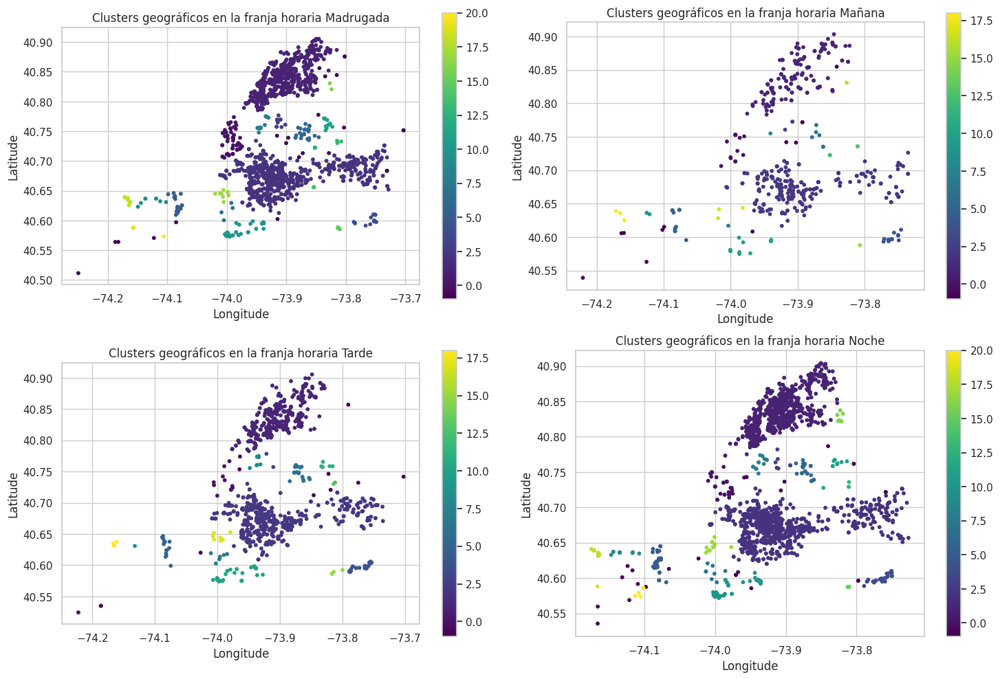

In [79]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from shapely.geometry import Point
import geopandas as gpd # This line was missing

# Convertir el DataFrame a un GeoDataFrame
geometry = [Point(xy) for xy in zip(df_fatalResoult['Longitude'], df_fatalResoult['Latitude'])]
gdf = gpd.GeoDataFrame(df_fatalResoult, geometry=geometry)

# Crear un gráfico con cuatro cuadros
fig, axs = plt.subplots(2, 2, figsize=(15, 10))

# Visualizar los resultados del clustering geográfico según distintas franjas horarias
for i, rango_horario in enumerate(['Madrugada', 'Mañana', 'Tarde', 'Noche']):
    subset = gdf[gdf['Rango_Horario'] == rango_horario]
    ax = axs[i // 2, i % 2]
    # Assuming 'cluster' column contains cluster labels
    subset.plot(ax=ax, column='cluster', cmap='viridis', legend=True, markersize=10)
    ax.set_title(f'Clusters geográficos en la franja horaria {rango_horario}')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

plt.tight_layout()
plt.show()


In [80]:
import pandas as pd
# Filtrar los datasets por franja horaria
df_madrugada = df_fatalResoult[df_fatalResoult['Rango_Horario'] == 'Madrugada']
df_manana = df_fatalResoult[df_fatalResoult['Rango_Horario'] == 'Mañana']
df_tarde = df_fatalResoult[df_fatalResoult['Rango_Horario'] == 'Tarde']
df_noche = df_fatalResoult[df_fatalResoult['Rango_Horario'] == 'Noche']

#Mapas segun el horario
Divido el dataset segun las frangas horarias ya que el mapa de fatalidad diferira segun el horario del enfrentamiento asi podremos tener en el mapa que lugares son mas propensos a terminar en una victima fatal.

#Madrugada

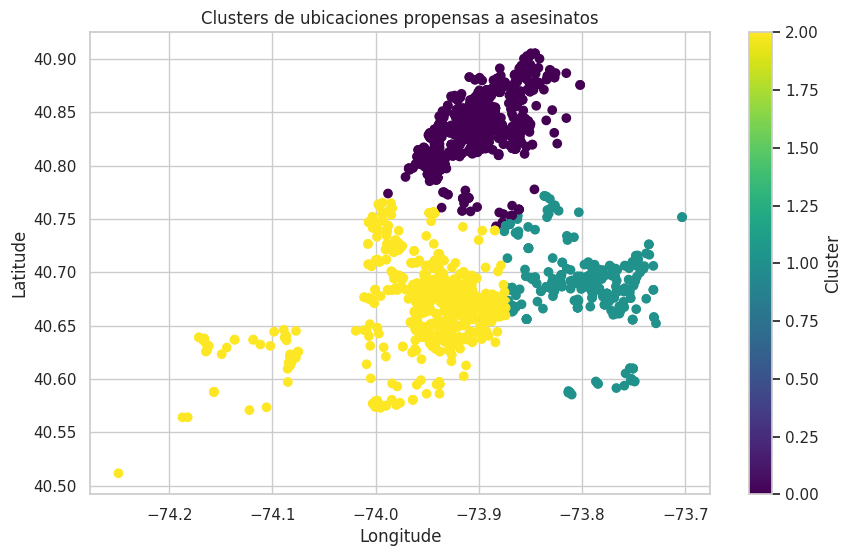

In [92]:

# Aplicar K-Means
kmeans = KMeans(n_clusters=3, random_state=42)
df_madrugada['cluster'] = kmeans.fit_predict(df_madrugada[['Latitude', 'Longitude']])

# Visualizar los resultados
plt.figure(figsize=(10, 6))
plt.scatter(df_madrugada['Longitude'], df_madrugada['Latitude'], c=df_madrugada['cluster'], cmap='viridis', marker='o')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Clusters de ubicaciones propensas a asesinatos')
plt.colorbar(label='Cluster')
plt.show()

In [82]:
# Crear un mapa centrado en una ubicación específica siendo la media de las latitudes y longotudes
m = folium.Map(location=[df_madrugada['Latitude'].mean(), df_madrugada['Longitude'].mean()], zoom_start=11)

for idx, row in df_madrugada.iterrows():
    if row['cluster'] == 2:
        color = 'red'
    elif row['cluster'] == 1:
        color = 'green'
    else:
        color = 'blue'

    folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius=2, color=color).add_to(m)
m

#Mañana

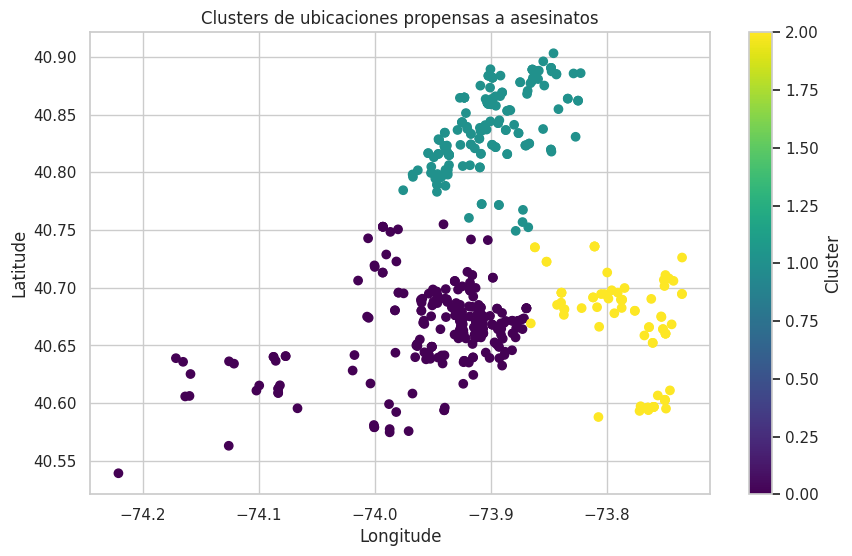

In [83]:
# Aplicar K-Means
kmeans = KMeans(n_clusters=3, random_state=42)
df_manana['cluster'] = kmeans.fit_predict(df_manana[['Latitude', 'Longitude']])

# Visualizar los resultados
plt.figure(figsize=(10, 6))
plt.scatter(df_manana['Longitude'], df_manana['Latitude'], c=df_manana['cluster'], cmap='viridis', marker='o')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Clusters de ubicaciones propensas a asesinatos')
plt.colorbar(label='Cluster')
plt.show()

In [84]:
# Crear un mapa centrado en una ubicación específica siendo la media de las latitudes y longotudes
m = folium.Map(location=[df_manana['Latitude'].mean(), df_manana['Longitude'].mean()], zoom_start=11)

for idx, row in df_manana.iterrows():
    if row['cluster'] == 2:
        color = 'red'
    elif row['cluster'] == 1:
        color = 'green'
    else:
        color = 'blue'

    folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius=2, color=color).add_to(m)
m

#Tarde

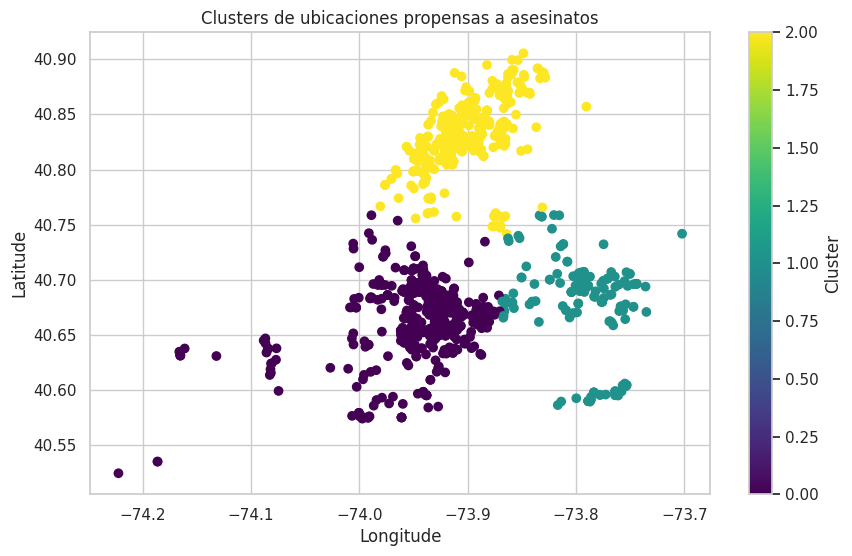

In [86]:
# Aplicar K-Means
kmeans = KMeans(n_clusters=3, random_state=42)
df_tarde['cluster'] = kmeans.fit_predict(df_tarde[['Latitude', 'Longitude']])

# Visualizar los resultados
plt.figure(figsize=(10, 6))
plt.scatter(df_tarde['Longitude'], df_tarde['Latitude'], c=df_tarde['cluster'], cmap='viridis', marker='o')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Clusters de ubicaciones propensas a asesinatos')
plt.colorbar(label='Cluster')
plt.show()

In [88]:
# Crear un mapa centrado en una ubicación específica siendo la media de las latitudes y longotudes
m = folium.Map(location=[df_tarde['Latitude'].mean(), df_tarde['Longitude'].mean()], zoom_start=11)

for idx, row in df_tarde.iterrows():
    if row['cluster'] == 2:
        color = 'red'
    elif row['cluster'] == 1:
        color = 'green'
    else:
        color = 'blue'

    folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius=2, color=color).add_to(m)
m

#Noche

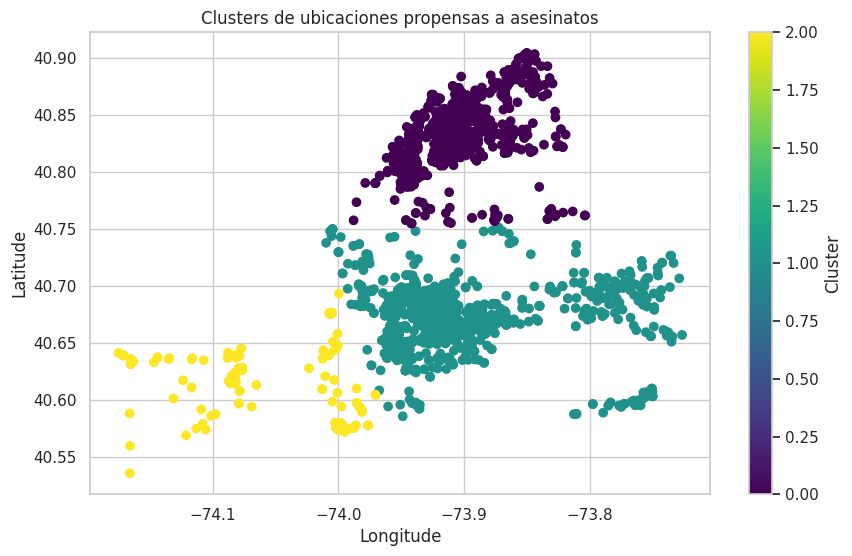

In [89]:
# Aplicar K-Means
kmeans = KMeans(n_clusters=3, random_state=42)
df_noche['cluster'] = kmeans.fit_predict(df_noche[['Latitude', 'Longitude']])

# Visualizar los resultados
plt.figure(figsize=(10, 6))
plt.scatter(df_noche['Longitude'], df_noche['Latitude'], c=df_noche['cluster'], cmap='viridis', marker='o')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Clusters de ubicaciones propensas a asesinatos')
plt.colorbar(label='Cluster')
plt.show()

In [90]:
# Crear un mapa centrado en una ubicación específica siendo la media de las latitudes y longotudes
m = folium.Map(location=[df_noche['Latitude'].mean(), df_noche['Longitude'].mean()], zoom_start=11)

for idx, row in df_noche.iterrows():
    if row['cluster'] == 2:
        color = 'red'
    elif row['cluster'] == 1:
        color = 'green'
    else:
        color = 'blue'

    folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius=2, color=color).add_to(m)
m